In [430]:
from __future__ import division
import numpy as np
import inspect
from collections import defaultdict
import warnings
import sklearn.utils
from copy import deepcopy
from PIL import Image
import cv2
import csv
import os
import sys
from tqdm import tqdm, trange
from bs4 import BeautifulSoup
from sklearn.cluster import KMeans
from bokeh.plotting import figure, output_file, show

In [2]:
def parse_xml(images_dirs,
          image_set_filenames,
          annotations_dirs=[],
          classes=[],
          include_classes = 'all',
          exclude_truncated=False,
          exclude_difficult=False,
          ret=False,
          verbose=True):
    

    # Set class members.
    images_dirs = images_dirs
    annotations_dirs = annotations_dirs
    image_set_filenames = image_set_filenames
    classes = classes
    include_classes = include_classes

    # Erase data that might have been parsed before.
    filenames = []
    image_ids = []
    labels = []
    eval_neutral = []
    #widthHeightRatio=[]
    anchor_info= []
    names =set()
    for images_dir, image_set_filename, annotations_dir in zip(images_dirs, image_set_filenames, annotations_dirs):
        # Read the image set file that so that we know all the IDs of all the images to be included in the dataset.
        with open(image_set_filename) as f:
            image_ids = [line.strip() for line in f] # Note: These are strings, not integers.
            image_ids += image_ids

        if verbose: it = tqdm(image_ids, desc="Processing image set '{}'".format(os.path.basename(image_set_filename)), file=sys.stdout)
        else: it = image_ids

        # Loop over all images in this dataset.
        for image_id in it:

            filename = '{}'.format(image_id) + '.pgm'#改变为pgm
            filenames.append(os.path.join(images_dir, filename))

            if not annotations_dir is None:
                # Parse the XML file for this image.
                with open(os.path.join(annotations_dir, image_id + '.xml')) as f:
                    soup = BeautifulSoup(f, 'xml')

                folder = soup.folder.text # In case we want to return the folder in addition to the image file name. Relevant for determining which dataset an image belongs to.
                #filename = soup.filename.text

                boxes = [] # We'll store all boxes for this image here.
                eval_neutr = [] # We'll store whether a box is annotated as "difficult" here.
                objects = soup.find_all('object') # Get a list of all objects in this image.

                # Parse the data for each object.
                for obj in objects:
                    class_name = obj.find('name', recursive=False).text
                    names.add(class_name)
                    #print(class_name)
                    class_id = classes.index(class_name)
                    # Check whether this class is supposed to be included in the dataset.
                    if (not include_classes == 'all') and (not class_id in include_classes): continue
                    pose = obj.find('pose', recursive=False).text
                    truncated = int(obj.find('truncated', recursive=False).text)
                    if exclude_truncated and (truncated == 1): continue
                    difficult = int(obj.find('difficult', recursive=False).text)
                    if exclude_difficult and (difficult == 1): continue
                    # Get the bounding box coordinates.
                    bndbox = obj.find('bndbox', recursive=False)
                    xmin = int(bndbox.xmin.text)
                    ymin = int(bndbox.ymin.text)
                    xmax = int(bndbox.xmax.text)
                    ymax = int(bndbox.ymax.text)
                    width = abs(xmax-xmin)
                    height = abs(ymax-ymin)
                    #widthAndHeightRatio = round(width/height,1)
                    #widthHeightRatio.append(widthAndHeightRatio)
                    
                    temp_anchor_info = [class_name,(xmin+xmax)/2,(ymin+ymax)/2,width,height]
                    anchor_info.append(temp_anchor_info)

    dataset_size = len(filenames)
    dataset_indices = np.arange(dataset_size, dtype=np.int32)
    return anchor_info#widthHeightRatio



In [3]:
VOC_2007_images_dir = '../data_index/data/pic/'

# The directories that contain the annotations.
VOC_2007_annotations_dir = '../data_index/data/label/'

VOC_2007_trainval_image_set_filename = '../data_index/data/train.txt'
#VOC_2012_trainval_image_set_filename = '../../datasets/VOCdevkit/VOC2012/ImageSets/Main/trainval.txt'
VOC_2007_test_image_set_filename     = '../data_index/data/val.txt'

# The XML parser needs to now what object class names to look for and in which order to map them to integers.
#classes = ['background','human','bicycle','truck','car','bus','motorbike','escooter']
classes = ['background','human','bicycle','truck','car','bus','escooter','motorbike']

res = parse_xml(images_dirs=[VOC_2007_images_dir],
                        image_set_filenames=[VOC_2007_trainval_image_set_filename],
                        annotations_dirs=[VOC_2007_annotations_dir],
                        classes=classes,
                        include_classes='all',
                        exclude_truncated=False,
                        exclude_difficult=False,
                        ret=False)

Processing image set 'train.txt': 100%|██████████| 25792/25792 [00:24<00:00, 1046.21it/s]


In [11]:
print(res)

[1.0, 0.5, 0.9, 0.5, 1.0, 0.7, 1.1, 1.0, 0.2, 0.6, 0.4, 0.5, 1.1, 0.8, 0.7, 1.0, 1.0, 1.1, 1.1, 1.0, 1.0, 0.9, 0.2, 1.0, 0.3, 0.4, 1.0, 0.4, 1.1, 1.0, 1.1, 1.0, 1.1, 1.1, 0.9, 0.4, 1.0, 0.9, 0.9, 0.8, 0.7, 1.0, 0.8, 0.9, 0.9, 0.2, 1.1, 0.3, 0.5, 1.1, 0.2, 0.8, 1.1, 0.2, 1.0, 0.3, 0.9, 0.8, 1.1, 0.6, 1.1, 0.2, 1.0, 1.0, 0.9, 0.9, 1.0, 1.1, 0.8, 1.0, 1.1, 1.0, 0.2, 1.0, 1.1, 1.0, 1.0, 0.9, 0.9, 1.0, 0.3, 0.3, 0.7, 0.9, 1.1, 1.0, 0.9, 0.9, 0.5, 1.0, 1.0, 1.1, 1.1, 0.9, 1.0, 0.9, 0.7, 1.1, 0.8, 0.6, 0.9, 1.1, 0.7, 1.0, 1.1, 1.1, 0.9, 0.8, 1.0, 0.9, 0.8, 0.4, 0.2, 1.0, 0.7, 0.8, 0.2, 1.3, 2.5, 2.4, 2.1, 1.3, 1.6, 2.4, 2.5, 2.5, 2.5, 2.1, 2.6, 1.0, 2.6, 1.7, 1.3, 2.5, 2.9, 2.6, 1.2, 1.5, 2.3, 2.7, 1.5, 2.8, 2.5, 1.0, 1.1, 2.3, 2.6, 1.6, 2.1, 2.6, 2.6, 2.5, 2.4, 2.5, 2.4, 2.5, 2.1, 1.1, 1.4, 2.2, 1.8, 2.5, 2.6, 2.2, 0.9, 1.2, 2.5, 2.3, 2.8, 2.5, 2.4, 2.3, 2.4, 1.3, 1.4, 2.4, 1.8, 2.9, 2.0, 1.9, 2.5, 1.6, 1.1, 1.9, 2.0, 1.8, 2.5, 2.5, 1.6, 0.9, 1.6, 1.5, 1.5, 2.8, 1.3, 1.1, 2.3, 2.5, 2.4, 1.5,

In [4]:
dic = {}
for i in res:
    if i in dic:
        dic[i]+=1
    else:
        dic[i]=1

TypeError: unhashable type: 'list'

In [13]:
print(dic)

{1.0: 4092, 0.5: 1508, 0.9: 3380, 0.7: 1690, 1.1: 1166, 0.2: 2466, 0.6: 1594, 0.4: 2904, 0.8: 2094, 0.3: 4298, 1.3: 220, 2.5: 268, 2.4: 264, 2.1: 218, 1.6: 178, 2.6: 140, 1.7: 160, 2.9: 76, 1.2: 368, 1.5: 166, 2.3: 282, 2.7: 88, 2.8: 78, 1.4: 194, 2.2: 252, 1.8: 174, 2.0: 206, 1.9: 168, 3.0: 44, 3.2: 10, 3.1: 28, 3.4: 6, 3.7: 2, 3.5: 2, 3.3: 6, 0.1: 92}


In [44]:
print(len(dic))

36


In [15]:
import numpy as np
from numpy.random import randn
import matplotlib as mpl
import matplotlib.pyplot as plt


(array([9.200e+01, 6.764e+03, 0.000e+00, 2.904e+03, 1.508e+03, 3.284e+03,
        0.000e+00, 2.094e+03, 3.380e+03, 4.092e+03, 1.534e+03, 2.200e+02,
        1.940e+02, 1.660e+02, 0.000e+00, 3.380e+02, 1.740e+02, 1.680e+02,
        0.000e+00, 2.060e+02, 2.180e+02, 5.340e+02, 2.640e+02, 2.680e+02,
        0.000e+00, 1.400e+02, 1.660e+02, 7.600e+01, 4.400e+01, 0.000e+00,
        2.800e+01, 1.600e+01, 6.000e+00, 2.000e+00, 0.000e+00, 2.000e+00]),
 array([0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1. , 1.1, 1.2, 1.3,
        1.4, 1.5, 1.6, 1.7, 1.8, 1.9, 2. , 2.1, 2.2, 2.3, 2.4, 2.5, 2.6,
        2.7, 2.8, 2.9, 3. , 3.1, 3.2, 3.3, 3.4, 3.5, 3.6, 3.7]),
 <BarContainer object of 36 artists>)

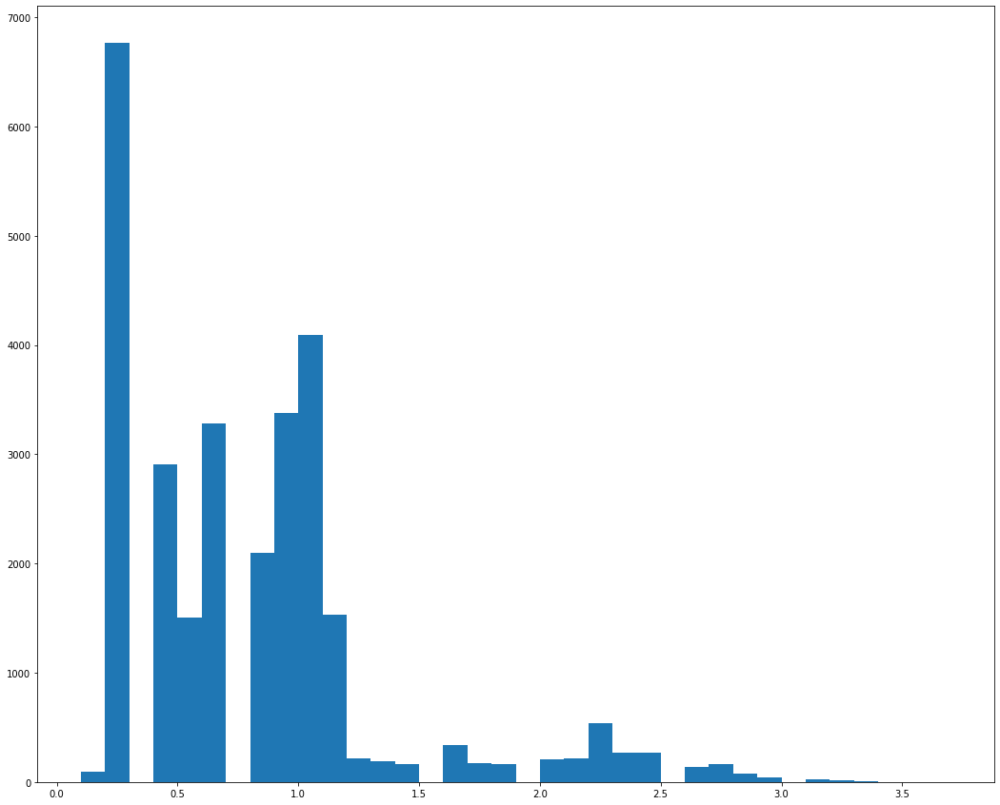

In [45]:
plt.hist(res, bins=36, alpha=1)


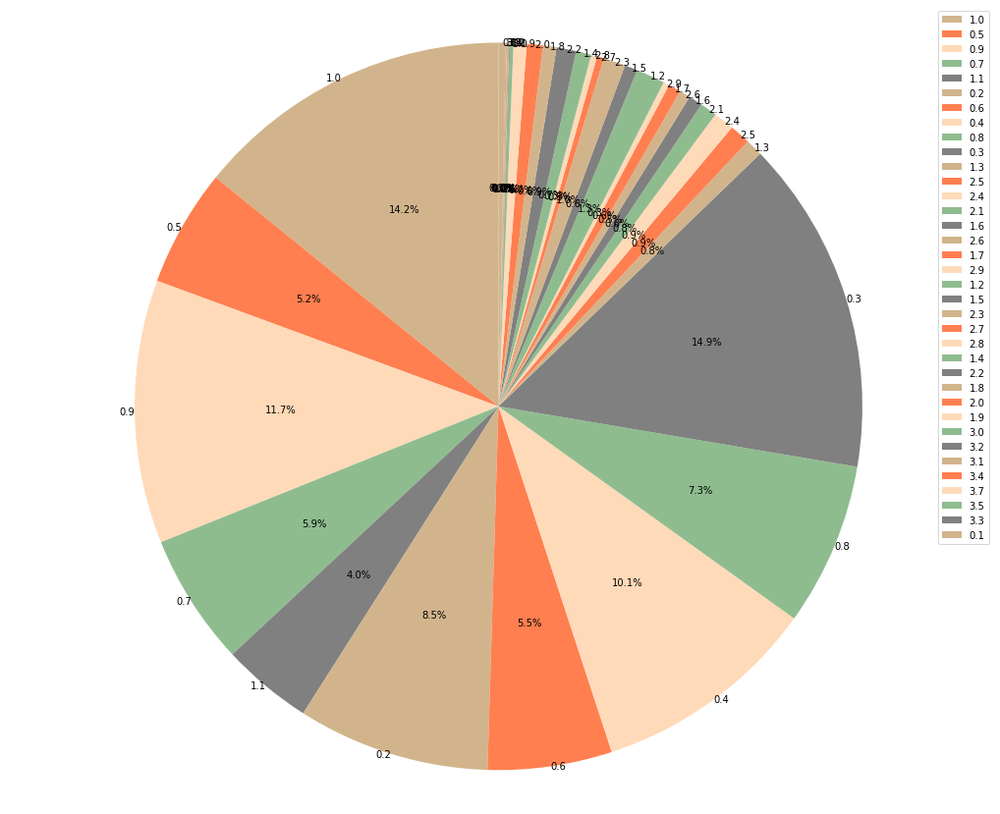

In [42]:
mpl.rcParams['font.sans-serif'] = ['SimHei']
mpl.rcParams['axes.unicode_minus'] = False

label_list = dic.keys()    # 各部分标签
size = dic.values()    # 各部分大小
color = ["tan", "coral", "peachpuff",'darkseagreen','grey']     # 各部分颜色
"""
绘制饼图
explode：设置各部分突出
label:设置各部分标签
labeldistance:设置标签文本距圆心位置，1.1表示1.1倍半径
autopct：设置圆里面文本
shadow：设置是否有阴影
startangle：起始角度，默认从0开始逆时针转
pctdistance：设置圆内文本距圆心距离
返回值
l_text：圆内部文本，matplotlib.text.Text object
p_text：圆外部文本
"""
plt.rcParams['figure.figsize'] = (18.0, 15.0)
patches, l_text, p_text = plt.pie(size, colors=color, labels=label_list, labeldistance=1, autopct="%1.1f%%", shadow=False, startangle=90, pctdistance=0.6)
plt.axis("equal")    # 设置横轴和纵轴大小相等，这样饼才是圆的
plt.legend()
plt.show()

In [9]:
print(res)

[['bicycle', 129.5, 134.5, 69, 67], ['bicycle', 285.5, 147.5, 69, 145], ['bicycle', 79.5, 142.0, 91, 96], ['bicycle', 34.0, 149.0, 66, 138], ['bicycle', 156.0, 136.0, 64, 66], ['bicycle', 32.0, 124.0, 44, 60], ['bicycle', 195.5, 142.5, 83, 77], ['bicycle', 83.0, 131.5, 68, 71], ['human', 223.5, 148.0, 37, 172], ['bicycle', 24.5, 123.5, 43, 71], ['bicycle', 13.5, 119.5, 25, 67], ['bicycle', 18.5, 123.0, 35, 66], ['bicycle', 124.0, 134.0, 68, 64], ['bicycle', 45.5, 128.5, 55, 71], ['bicycle', 33.5, 124.0, 51, 72], ['bicycle', 282.5, 148.0, 75, 74], ['bicycle', 265.0, 144.5, 76, 75], ['bicycle', 116.5, 133.5, 79, 75], ['bicycle', 94.5, 131.0, 69, 64], ['bicycle', 281.5, 148.5, 77, 75], ['bicycle', 92.0, 131.0, 76, 74], ['bicycle', 62.0, 128.5, 70, 75], ['human', 161.0, 149.0, 38, 174], ['bicycle', 133.5, 137.5, 69, 71], ['human', 286.0, 158.0, 52, 164], ['bicycle', 12.5, 122.5, 23, 65], ['bicycle', 148.5, 135.5, 79, 77], ['bicycle', 14.5, 119.5, 27, 61], ['bicycle', 266.0, 146.5, 84, 75],

In [8]:
N = 4000
x = np.random.random(size=N) * 100
y = np.random.random(size=N) * 100
radii = np.random.random(size=N) * 10
colors = np.array([ [r, g, 150] for r, g in zip(50 + 2*x, 30 + 2*y) ], dtype="uint8")

TOOLS="hover,crosshair,pan,wheel_zoom,zoom_in,zoom_out,box_zoom,undo,redo,reset,tap,save,box_select,poly_select,lasso_select,"

p = figure(tools=TOOLS)

p.scatter(x, y, marker="square", size=radii,
          fill_color=colors, fill_alpha=0.6,
          line_color=None)

output_file("color_scatter.html", title="color_scatter.py example")

show(p)  # open a browser

In [6]:
x, y, size, colors = [],[],[],[]
x_bi,x_hu,x_car,y_bi,y_hu,y_car=[],[],[],[],[],[]

for i in res:
    x.append(i[1])
    y.append(i[2])
    size.append((i[3]*i[4])/2)
    if i[0]=='human':
        colors.append([252,157,154])#truck','car','bus','escooter','motorbike']
        x_hu.append(i[1])
        y_hu.append(i[2])
    elif i[0]=='bicycle':
        colors.append([249,205,173])
        x_bi.append(i[1])
        y_bi.append(i[2])
    elif i[0]=='car':
        colors.append([131,175,155])
        x_car.append(i[1])
        y_car.append(i[2])
    elif i[0]=='truck':
        colors.append([200,200,150])
    elif i[0]=='bus':
        colors.append([230,100,150])
    elif i[0]=='escooter':
        colors.append([100,50,200])
    elif i[0]=='motorbike':
        colors.append([30,150,150])
    else:
        colors.append([250,250,250])
        
        
        
        

In [7]:
TOOLS="hover,crosshair,pan,wheel_zoom,zoom_in,zoom_out,box_zoom,undo,redo,reset,tap,save,box_select,poly_select,lasso_select,"

p = figure(tools=TOOLS)

p.scatter(x, y, radius=1.5,
          fill_color=colors, fill_alpha=0.3,
          line_color=None)

output_file("color_scatter.html", title="color_scatter.py example")

show(p)  # open a browser

In [9]:
TOOLS="hover,crosshair,pan,wheel_zoom,zoom_in,zoom_out,box_zoom,undo,redo,reset,tap,save,box_select,poly_select,lasso_select,"

p = figure(tools=TOOLS)

p.scatter(x_bi, y_bi, radius=1.5,
          fill_color=[[249,205,173] for i in range(len(x_bi))], fill_alpha=0.6,
          line_color=None)

output_file("color_scatter_.html", title="bicycle")

show(p)  # open a browser

In [11]:
# Do a K-means to cluster the bicycle points into three part, and 
kmeans = KMeans(n_clusters=3, random_state=0).fit(x_bi)

ValueError: Expected 2D array, got 1D array instead:
array=[129.5 285.5  79.5 ...  25.5 251.5 170. ].
Reshape your data either using array.reshape(-1, 1) if your data has a single feature or array.reshape(1, -1) if it contains a single sample.

In [59]:
TOOLS="hover,crosshair,pan,wheel_zoom,zoom_in,zoom_out,box_zoom,undo,redo,reset,tap,save,box_select,poly_select,lasso_select,"

p = figure(tools=TOOLS)

p.scatter(x_car, y_car, radius=1.5,
          fill_color=[[131,175,155] for i in range(len(x_car))], fill_alpha=0.6,
          line_color=None)

output_file("color_scatter_.html", title="car")

show(p)  # open a browser

In [60]:
TOOLS="hover,crosshair,pan,wheel_zoom,zoom_in,zoom_out,box_zoom,undo,redo,reset,tap,save,box_select,poly_select,lasso_select,"

p = figure(tools=TOOLS)

p.scatter(x_hu, y_hu, radius=1.5,
          fill_color=[[252,157,154] for i in range(len(x_hu))], fill_alpha=0.6,
          line_color=None)

output_file("color_scatter_.html", title="car")

show(p)  # open a browser

# Calculate position-speed factor to calibrate kalman filter prediction in tracking

The traffic counter use a fish-eye lens to record videos for object tracking, the huge distortion of the lens and the different perspectives caused by the moving object have a great effect on object tracking. In our assumption as well observation, most objects in the recorded sequences can be seen as moving in a constant velocity in a short path, which is covered by the traffic counter. But the distortion and changing perspectives make the velocity of a moving object to be very unstable, and thus it increase the dificulty for kalman filter to predict the accurate position of the moving object. We will do the statistic and analyse to find a solution, which helps to reduce the effect of len distortion and perspective to the kalman filter prediction.

We separate objects in three categories according to the distance between the moving object and the camera, which are small scale (long distance), middle scale (middle distance) as well big scale (short distance). The heights of objects in the begining or the end of a sequence can reflect the object's scale well. 

Due to the time limit, we take all bicycle class for example to do the analysis.

In [12]:
#take bicycles in the range [0,50] and[270,320]
def parse_xml_filter_bicycle (images_dirs,
          image_set_filenames,
          annotations_dirs=[],
          classes=[],
          include_classes = 'all',
          exclude_truncated=False,
          exclude_difficult=False,
          ret=False,
          verbose=True):
    

    # Set class members.
    images_dirs = images_dirs
    annotations_dirs = annotations_dirs
    image_set_filenames = image_set_filenames
    classes = classes
    include_classes = include_classes

    # Erase data that might have been parsed before.
    filenames = []
    image_ids = []
    labels = []
    eval_neutral = []
    #widthHeightRatio=[]
    anchor_info= []
    names =set()
    for images_dir, image_set_filename, annotations_dir in zip(images_dirs, image_set_filenames, annotations_dirs):
        # Read the image set file that so that we know all the IDs of all the images to be included in the dataset.
        with open(image_set_filename) as f:
            image_ids = [line.strip() for line in f] # Note: These are strings, not integers.
            image_ids += image_ids

        if verbose: it = tqdm(image_ids, desc="Processing image set '{}'".format(os.path.basename(image_set_filename)), file=sys.stdout)
        else: it = image_ids

        # Loop over all images in this dataset.
        for image_id in it:

            filename = '{}'.format(image_id) + '.pgm'#改变为pgm
            filenames.append(os.path.join(images_dir, filename))

            if not annotations_dir is None:
                # Parse the XML file for this image.
                with open(os.path.join(annotations_dir, image_id + '.xml')) as f:
                    soup = BeautifulSoup(f, 'xml')

                folder = soup.folder.text # In case we want to return the folder in addition to the image file name. Relevant for determining which dataset an image belongs to.
                #filename = soup.filename.text

                boxes = [] # We'll store all boxes for this image here.
                eval_neutr = [] # We'll store whether a box is annotated as "difficult" here.
                objects = soup.find_all('object') # Get a list of all objects in this image.

                # Parse the data for each object.
                for obj in objects:
                    class_name = obj.find('name', recursive=False).text
                    names.add(class_name)
                    #print(class_name)
                    class_id = classes.index(class_name)
                    # Check whether this class is supposed to be included in the dataset.
                    if (not include_classes == 'all') and (not class_id in include_classes): continue
                    pose = obj.find('pose', recursive=False).text
                    truncated = int(obj.find('truncated', recursive=False).text)
                    if exclude_truncated and (truncated == 1): continue
                    difficult = int(obj.find('difficult', recursive=False).text)
                    if exclude_difficult and (difficult == 1): continue
                    # Get the bounding box coordinates.
                    bndbox = obj.find('bndbox', recursive=False)
                    xmin = int(bndbox.xmin.text)
                    ymin = int(bndbox.ymin.text)
                    xmax = int(bndbox.xmax.text)
                    ymax = int(bndbox.ymax.text)
                    width = abs(xmax-xmin)
                    height = abs(ymax-ymin)
                    #widthAndHeightRatio = round(width/height,1)
                    #widthHeightRatio.append(widthAndHeightRatio)
                    if class_name =='bicycle':
                        # filter the bicycle in left and right side of the picture
                        if 0<(xmin+xmax)/2<=50 or 270<=(xmin+xmax)/2<320:
                                temp_anchor_info = [class_name,(xmin+xmax)/2,(ymin+ymax)/2,width,height]
                                anchor_info.append(temp_anchor_info)

    dataset_size = len(filenames)
    dataset_indices = np.arange(dataset_size, dtype=np.int32)
    return anchor_info#widthHeightRatio



In [13]:
VOC_2007_images_dir = '../data_index/data/pic/'

# The directories that contain the annotations.
VOC_2007_annotations_dir = '../data_index/data/label/'

VOC_2007_trainval_image_set_filename = '../data_index/data/train.txt'
#VOC_2012_trainval_image_set_filename = '../../datasets/VOCdevkit/VOC2012/ImageSets/Main/trainval.txt'
VOC_2007_test_image_set_filename     = '../data_index/data/val.txt'

# The XML parser needs to now what object class names to look for and in which order to map them to integers.
#classes = ['background','human','bicycle','truck','car','bus','motorbike','escooter']
classes = ['background','human','bicycle','truck','car','bus','escooter','motorbike']

res_bicycle = parse_xml_filter_bicycle(images_dirs=[VOC_2007_images_dir],
                        image_set_filenames=[VOC_2007_trainval_image_set_filename],
                        annotations_dirs=[VOC_2007_annotations_dir],
                        classes=classes,
                        include_classes='all',
                        exclude_truncated=False,
                        exclude_difficult=False,
                        ret=False)

Processing image set 'train.txt': 100%|██████████| 25792/25792 [00:24<00:00, 1037.60it/s]


In [14]:
len(res_bicycle)

5776

### Use k-means to set the scale boundary of small, middle and big object, with the help of which we will separate the objects in different distances.


In [134]:
import numpy as np
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
%matplotlib inline
import os
import matplotlib as mpl
from scipy.optimize import leastsq


In [35]:
input_array = []
for i in res_bicycle:
    input_array.append([0,i[-1]])

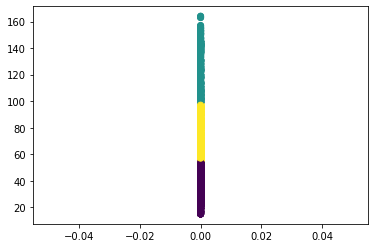

In [30]:
T = np.array(input_array)

y_pred = KMeans(n_clusters=3, random_state=9).fit_predict(T)
plt.scatter(T[:, 0], T[:, 1], c=y_pred)
#plt.scatter(0, input_array[1], c=y_pred)
plt.show()

In [44]:
temp = y_pred.tolist()
print(len(temp))
near = []
middle = []
far =[]
for num,i in enumerate(temp):
    if i==0:
        near.append(input_array[num][1])
    elif i==1:
        far.append(input_array[num][1])
    else:
        middle.append(input_array[num][1])
    

5776


In [46]:
#use the min and max value in the middle scale object list to separate scales
middle_min = min(middle)
middle_max = max(middle)
print(middle_min,middle_max)

55 98


In [264]:
VOC_2007_images_dir = '../data_index/data/pic/'

# The directories that contain the annotations.
VOC_2007_annotations_dir = '../data_index/data/label/'

VOC_2007_trainval_image_set_filename = '../data_index/data/train.txt'
#VOC_2012_trainval_image_set_filename = '../../datasets/VOCdevkit/VOC2012/ImageSets/Main/trainval.txt'
VOC_2007_test_image_set_filename     = '../data_index/data/val.txt'

# The XML parser needs to now what object class names to look for and in which order to map them to integers.
#classes = ['background','human','bicycle','truck','car','bus','motorbike','escooter']
classes = ['background','bicycle','car']


In [265]:
def parse_xml_with_objList(images_dirs,
          image_ids=[],
          annotations_dirs='',
          classes=[],
          include_classes = 'all',
          exclude_truncated=False,
          exclude_difficult=False,
          ret=False,
          verbose=True):
    
    

    # Set class members.
    images_dirs = images_dirs
    annotations_dirs = annotations_dirs
  
    classes = classes
    include_classes = include_classes

    # Erase data that might have been parsed before.
    filenames = []
    labels = []
    eval_neutral = []
    #widthHeightRatio=[]
    anchor_info= []
    names = set()
    images_dir='../data_index/data/pic/'
    annotations_dir=annotations_dirs
    #print(annotations_dir)
    it = image_ids

        # Loop over all images in this dataset.
    for image_id in it:


        with open(os.path.join(annotations_dir, image_id + '.xml')) as f:
            soup = BeautifulSoup(f, 'xml')

        folder = soup.folder.text # In case we want to return the folder in addition to the image file name. Relevant for determining which dataset an image belongs to.
        #filename = soup.filename.text

        boxes = [] # We'll store all boxes for this image here.
        eval_neutr = [] # We'll store whether a box is annotated as "difficult" here.
        objects = soup.find_all('object') # Get a list of all objects in this image.

        # Parse the data for each object.
        for obj in objects:
            class_name = obj.find('name', recursive=False).text
            if class_name == 'bicycle':
                names.add(class_name)
                #print(class_name)
                class_id = classes.index(class_name)
                # Check whether this class is supposed to be included in the dataset.
                if (not include_classes == 'all') and (not class_id in include_classes): continue
                pose = obj.find('pose', recursive=False).text
                truncated = int(obj.find('truncated', recursive=False).text)
                if exclude_truncated and (truncated == 1): continue
                difficult = int(obj.find('difficult', recursive=False).text)
                if exclude_difficult and (difficult == 1): continue
                # Get the bounding box coordinates.
                bndbox = obj.find('bndbox', recursive=False)
                xmin = int(bndbox.xmin.text)
                ymin = int(bndbox.ymin.text)
                xmax = int(bndbox.xmax.text)
                ymax = int(bndbox.ymax.text)
                width = abs(xmax-xmin)
                height = abs(ymax-ymin)
                #widthAndHeightRatio = round(width/height,1)
                #widthHeightRatio.append(widthAndHeightRatio)

                temp_anchor_info = [class_name,(xmin+xmax)/2,(ymin+ymax)/2,image_id, width, height]
                #print(temp_anchor_info)
                anchor_info.append(temp_anchor_info)
            #print(anchor_info)

    
    return anchor_info#widthHeightRatio

In [269]:
#Filter all sequences that only contain single bicycle, and use these sequence to calculate the position-speed factor.
#Because such bicycle sequences have no occlusion, so that the futher calculation based on clean and complete bicycle sequences
near_seq_list = []
middle_seq_list = []
far_seq_list = []

seq_path = '../../Data_orderd_with_name_rules/train_data_object_detection/'
root_dirs = os.listdir(seq_path)
print(len(root_dirs))
# parse all sequences in train set and filter the none single
for i in root_dirs:
    sub_dir_path = seq_path+i+'/'
    sequence_dirs = os.listdir(sub_dir_path)
    for j in sequence_dirs:
        if j[-4:]=='0002':
            sequence_frame_list = os.listdir(sub_dir_path+'/'+j)
            temp_list = []
            for k in sequence_frame_list:
                if k[-3:]=='xml':
                    #print(k)
                    temp_list.append(k[:-4])
            temp_list.sort()
            temp_positio_res = parse_xml_with_objList(images_dirs=[VOC_2007_images_dir],
                        image_ids=temp_list,
                        annotations_dirs=sub_dir_path+'/'+j,
                        classes=classes,
                        include_classes='all',
                        exclude_truncated=False,
                        exclude_difficult=False,
                        ret=False)
            #print(temp_positio_res)
            if len(temp_positio_res)>0:
                
                if temp_positio_res[0][-1] <55:
                    far_seq_list.append(temp_positio_res)
                    #print(far_seq_list)
                elif temp_positio_res[0][-1] >98:
                    near_seq_list.append(temp_positio_res)
                else:
                    middle_seq_list.append(temp_positio_res)
                    #print(middle_seq_list)
                
                
                
        

32


In [270]:
print(near_seq_list[0])

[['bicycle', 56.0, 150.5, '192.168.43.213_1604568202948', 110, 141], ['bicycle', 98.5, 149.5, '192.168.43.213_1604568203142', 141, 139], ['bicycle', 126.5, 151.5, '192.168.43.213_1604568203246', 139, 137], ['bicycle', 181.5, 152.5, '192.168.43.213_1604568203381', 129, 135], ['bicycle', 228.5, 148.5, '192.168.43.213_1604568203508', 109, 127], ['bicycle', 248.5, 148.0, '192.168.43.213_1604568203607', 97, 124], ['bicycle', 282.0, 145.5, '192.168.43.213_1604568203768', 68, 113], ['bicycle', 293.5, 143.5, '192.168.43.213_1604568203924', 51, 105]]


In [271]:
# reorder every sequence to the same moving direction from left to right(infrom 0 to 320)
#separate sequence in different directions
near_seq_list_l2r = []
near_seq_list_r2l = []
middle_seq_list_l2r = []
middle_seq_list_r2l = []
far_seq_list_l2r = []
far_seq_list_r2l = []
all_seq = [near_seq_list, middle_seq_list, far_seq_list]
for num,i in enumerate(all_seq):
    for seq_list in i:
        #print(seq_list)
        if seq_list[0][1]>160:
            if num==0:
                near_seq_list_r2l.append(seq_list)
            elif num==1:
                middle_seq_list_r2l.append(seq_list)
            else:
                far_seq_list_r2l.append(seq_list)
        else:
            if num==0:
                near_seq_list_l2r.append(seq_list)
            elif num==1:
                middle_seq_list_l2r.append(seq_list)
            else:
                far_seq_list_l2r.append(seq_list)
            
            
#print(all_seq[0])
                    
                    
    

In [272]:
near_seq_list = all_seq[0]
middle_seq_list = all_seq[1]
far_seq_list = all_seq[2]

In [273]:
for i in middle_seq_list_r2l:
    print(i,'\n')

[['bicycle', 313.0, 124.0, '192.168.43.213_1605277241210', 14, 64], ['bicycle', 301.0, 126.0, '192.168.43.213_1605277241464', 32, 66], ['bicycle', 286.0, 128.0, '192.168.43.213_1605277241760', 42, 70], ['bicycle', 261.5, 129.5, '192.168.43.213_1605277242133', 49, 77], ['bicycle', 240.0, 131.0, '192.168.43.213_1605277242277', 58, 86], ['bicycle', 193.5, 134.0, '192.168.43.213_1605277242557', 73, 92], ['bicycle', 172.0, 136.5, '192.168.43.213_1605277242797', 82, 99], ['bicycle', 134.0, 137.5, '192.168.43.213_1605277243054', 94, 107], ['bicycle', 93.5, 138.0, '192.168.43.213_1605277243263', 103, 114], ['bicycle', 56.5, 136.5, '192.168.43.213_1605277243417', 97, 111], ['bicycle', 29.0, 139.0, '192.168.43.213_1605277243603', 56, 112], ['bicycle', 16.0, 138.5, '192.168.43.213_1605277243875', 30, 107]] 

[['bicycle', 297.5, 146.0, '192.168.43.211_1596987232164', 45, 82], ['bicycle', 291.0, 147.0, '192.168.43.211_1596987232279', 58, 90], ['bicycle', 270.5, 142.5, '192.168.43.211_1596987232392'

In [452]:
#the result format is like [(x1,factor1),(x2,factor2)...]

#current_d format [class_name,x_center,y_center,image_id(time), width, height]
count = 0
total_time = 0
def calculate_speed_of_the_detection(current_d, last_d):
    #print('time segments: ',int(current_d[3][-13:])-int(last_d[3][-13:]))
    factor =  round(abs(current_d[1]-last_d[1])/(int(current_d[3][-13:])-int(last_d[3][-13:])),2)
    #print(factor)
    if factor ==0:
        return 1
    return factor
    
    

def calculate_speedPosision_factor(seq_list,hypothesis='1',mode='visul'):
    count = 0
    total_time = 0
    result_list = []
    for num,i in enumerate(seq_list):
        seq_result = []
        last_factor = 0
        for num_detect,j in enumerate(i):
            if num_detect ==0 or num_detect==len(i)-1:
                if mode =='prediction_prep':
                    seq_result.append([j[1],j[2],j[-2],j[-1],0])
                else:
                    seq_result.append([j[1],1])
            else:
                if hypothesis=='1':
                    # the ratio reflects the distance of the current object to the position in next frame and the distance to the position in previous frame.
                    factor = round((i[num_detect+1][1]-i[num_detect][1])/(i[num_detect][1]-i[num_detect-1][1]),2)
                elif hypothesis=='2':
                    # the ratio reflects the distance of the current object to the position in next frame and the average distance of this kind of object per frame.
                    factor = round((i[num_detect+1][1]-i[num_detect][1])/(320/max(2,len(i)-1)),2)
                elif hypothesis =='3':
                    # the ratio reflects the speed(s) difference of (s_t+1 - s_t)/(s_t - s_t-1)
                    factor = round((i[num_detect+1][1]-i[num_detect][1])/(i[num_detect][1]-i[num_detect-1][1]),2)
                elif hypothesis =='4':
                    # the factor reflects the ratio between speed of next frame and the one of this frame
                    factor = round(calculate_speed_of_the_detection(i[num_detect+1],i[num_detect])/calculate_speed_of_the_detection(i[num_detect],i[num_detect-1]),2)
                elif hypothesis =='5':
                    # in this hypothesis, the factor only means the current speed, and the final target reflects (speed/height of the object)
                    factor = round(calculate_speed_of_the_detection(i[num_detect],i[num_detect-1]),2)
                    count+=1
                    total_time +=int(i[num_detect][3][-13:])-int(i[num_detect-1][3][-13:])
                if hypothesis !='5':
                    if abs(factor)>4 or abs(factor)<0.25:
                        factor = last_factor
                if mode =='prediction_prep':
                    seq_result.append([j[1],j[2],j[-2],j[-1],factor])
                else:
                    seq_result.append([j[1],factor])
                last_factor = factor
        result_list.append(seq_result)
        #print('average time per frame is :', total_time/count)
    return result_list
    

In [453]:
# result of hypothesis 1
near_seq_factor_l2r = calculate_speedPosision_factor(near_seq_list_l2r)
middle_seq_factor_l2r = calculate_speedPosision_factor(middle_seq_list_l2r)
far_seq_factor_l2r = calculate_speedPosision_factor(far_seq_list_l2r)

near_seq_factor_r2l = calculate_speedPosision_factor(near_seq_list_r2l)
middle_seq_factor_r2l = calculate_speedPosision_factor(middle_seq_list_r2l)
far_seq_factor_r2l = calculate_speedPosision_factor(far_seq_list_r2l)


In [433]:
for i in range(len(near_seq_list_l2r)):
    
    print(near_seq_list_l2r[i],'\n')
    print(near_seq_factor_l2r[i],'\n')

[['bicycle', 56.0, 150.5, '192.168.43.213_1604568202948', 110, 141], ['bicycle', 98.5, 149.5, '192.168.43.213_1604568203142', 141, 139], ['bicycle', 126.5, 151.5, '192.168.43.213_1604568203246', 139, 137], ['bicycle', 181.5, 152.5, '192.168.43.213_1604568203381', 129, 135], ['bicycle', 228.5, 148.5, '192.168.43.213_1604568203508', 109, 127], ['bicycle', 248.5, 148.0, '192.168.43.213_1604568203607', 97, 124], ['bicycle', 282.0, 145.5, '192.168.43.213_1604568203768', 68, 113], ['bicycle', 293.5, 143.5, '192.168.43.213_1604568203924', 51, 105]] 

[[56.0, 1], [98.5, 0.66], [126.5, 1.96], [181.5, 0.85], [228.5, 0.43], [248.5, 1.68], [282.0, 0.34], [293.5, 1]] 

[['bicycle', 50.0, 156.5, '192.168.43.213_1604568126332', 98, 163], ['bicycle', 82.5, 153.5, '192.168.43.213_1604568126483', 163, 171], ['bicycle', 106.5, 153.5, '192.168.43.213_1604568126623', 177, 171], ['bicycle', 160.0, 155.5, '192.168.43.213_1604568126745', 170, 167], ['bicycle', 187.0, 156.0, '192.168.43.213_1604568126888', 158

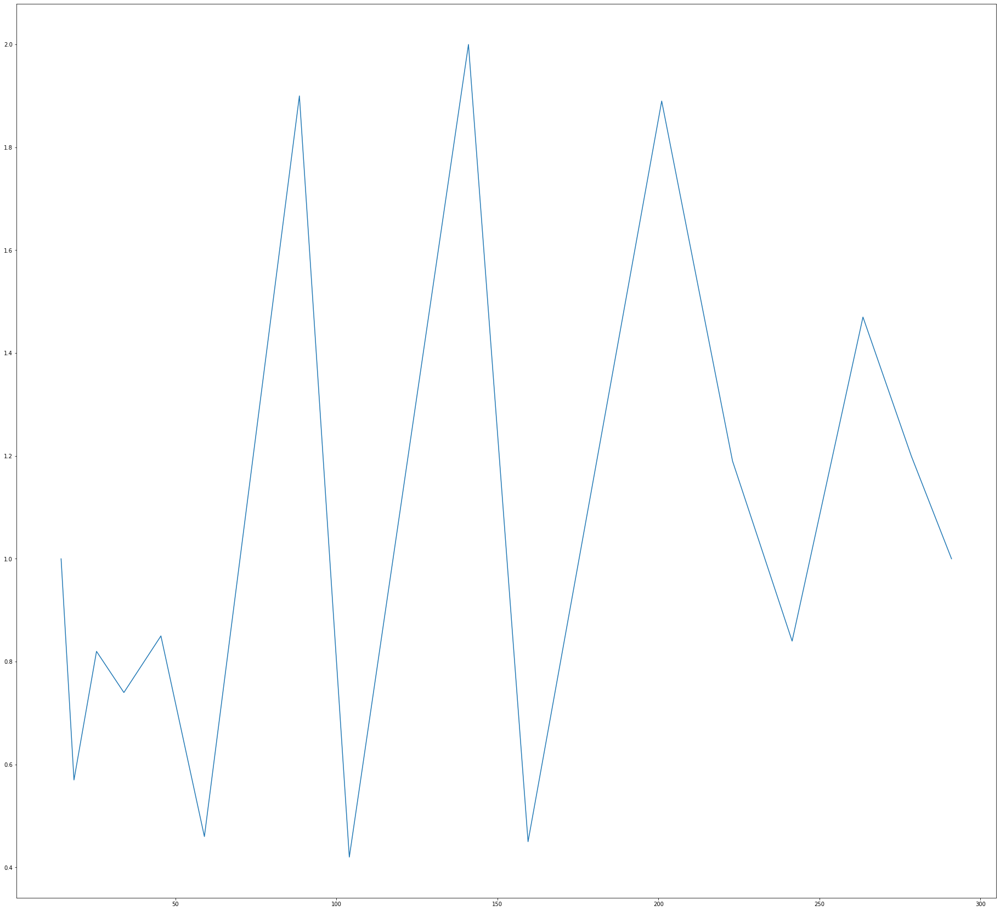

In [279]:
x,y = [],[]

for i in near_seq_factor_r2l:
    for j in i:
        x.append(j[0])
        y.append(j[1])
#p = plt.scatter(x,y)
plt.figure(figsize=(32, 30))
p = plt.plot(x,y)

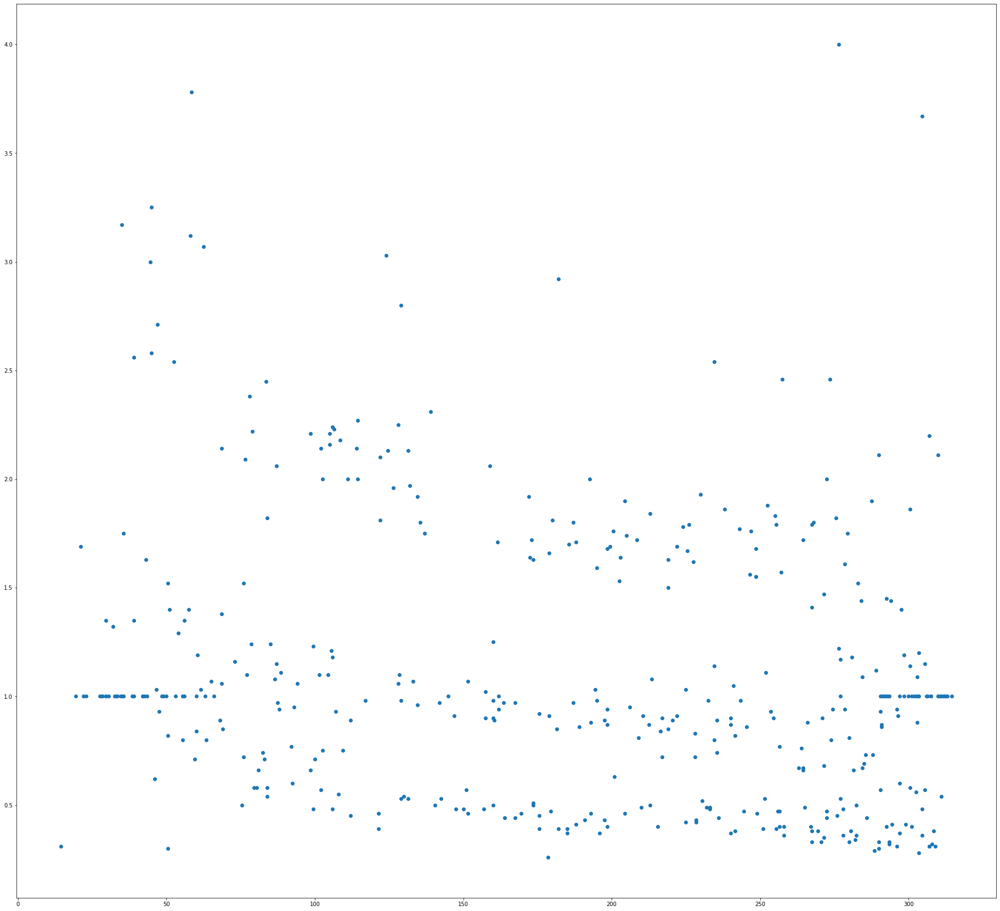

In [280]:
x,y = [],[]
for i in near_seq_factor_l2r:
    for j in i:
        x.append(j[0])
        y.append(j[1])
#p = plt.scatter(x,y)
plt.figure(figsize=(32, 30))
p = plt.plot(x,y)
plt.figure(figsize=(32, 30))
plt.xlabel('position in pixel',size=40)
plt.ylabel('speed in millisecond',size=40)
plt.xticks(size = 40)
plt.yticks(size = 40)
p = plt.plot(x,y)
plt.savefig('near_seq_factor_l2r_h1.png')

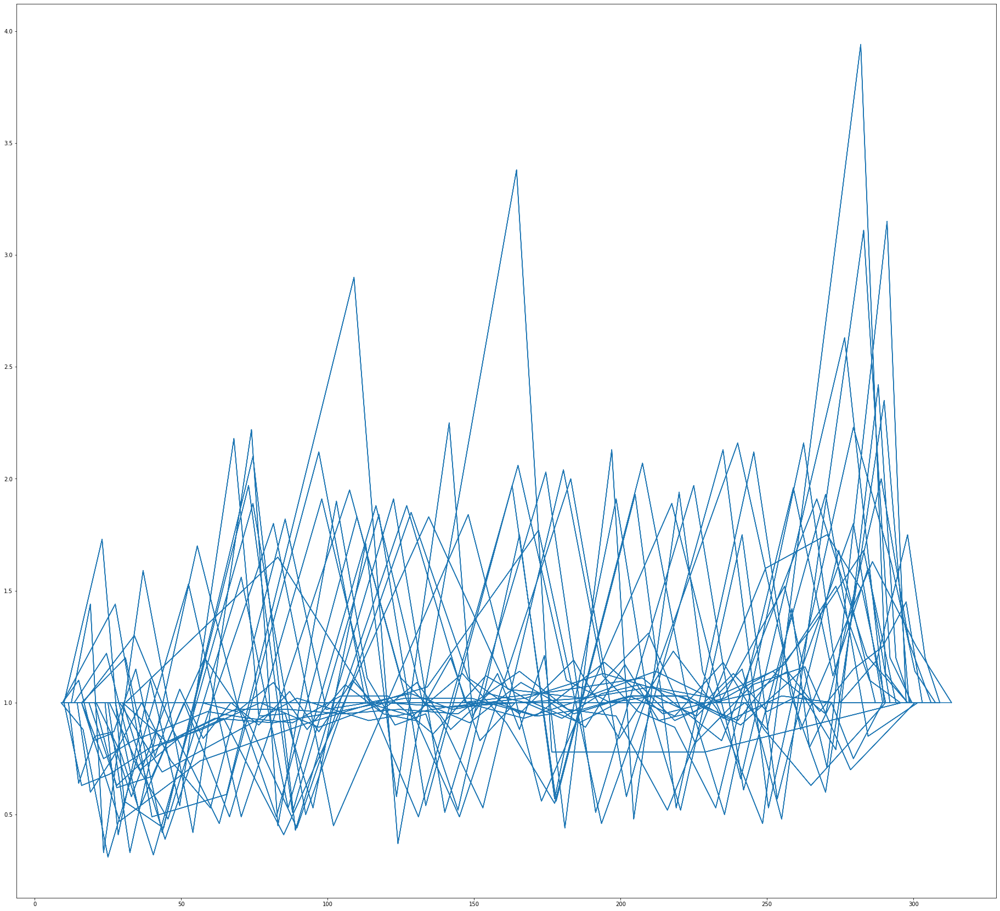

In [202]:
x,y = [],[]
for i in middle_seq_factor_r2l:
    for j in i:
        x.append(j[0])
        y.append(j[1])
#p = plt.scatter(x,y)
plt.figure(figsize=(32, 30))
p = plt.plot(x,y)

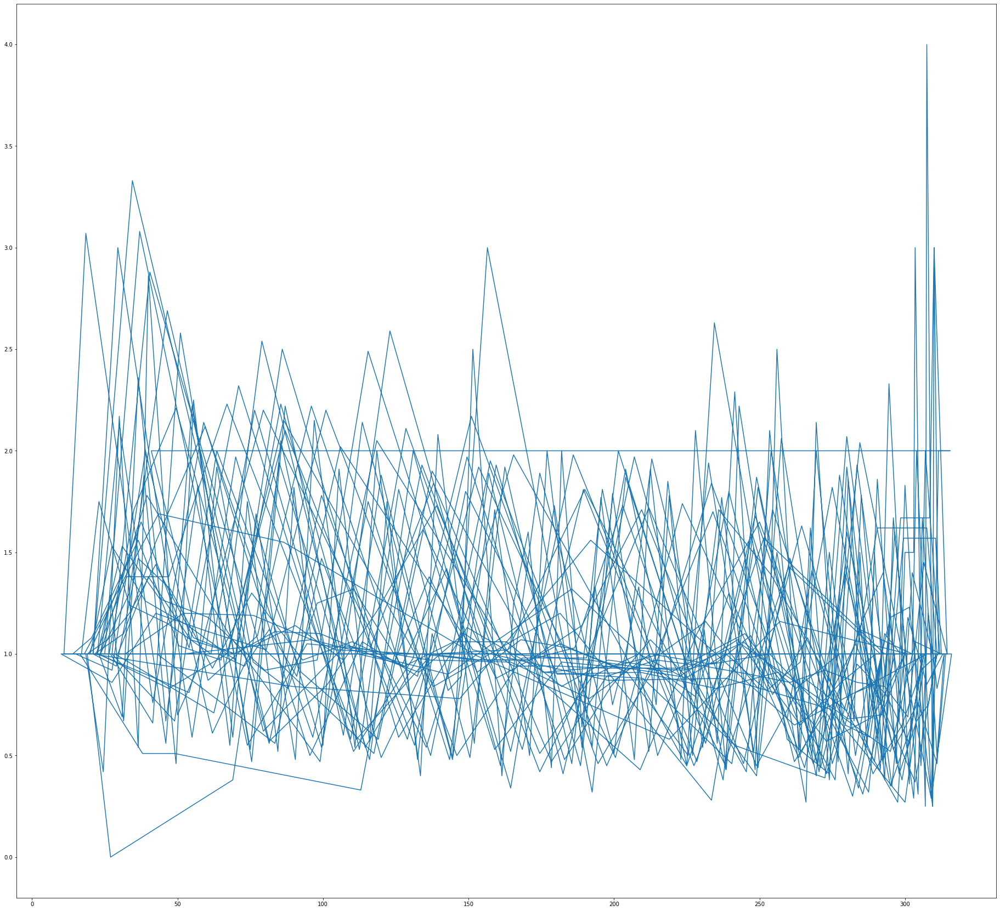

In [281]:
x,y = [],[]
for i in middle_seq_factor_l2r:
    for j in i:
        x.append(j[0])
        y.append(j[1])
#p = plt.scatter(x,y)
plt.figure(figsize=(32, 30))
p = plt.plot(x,y)

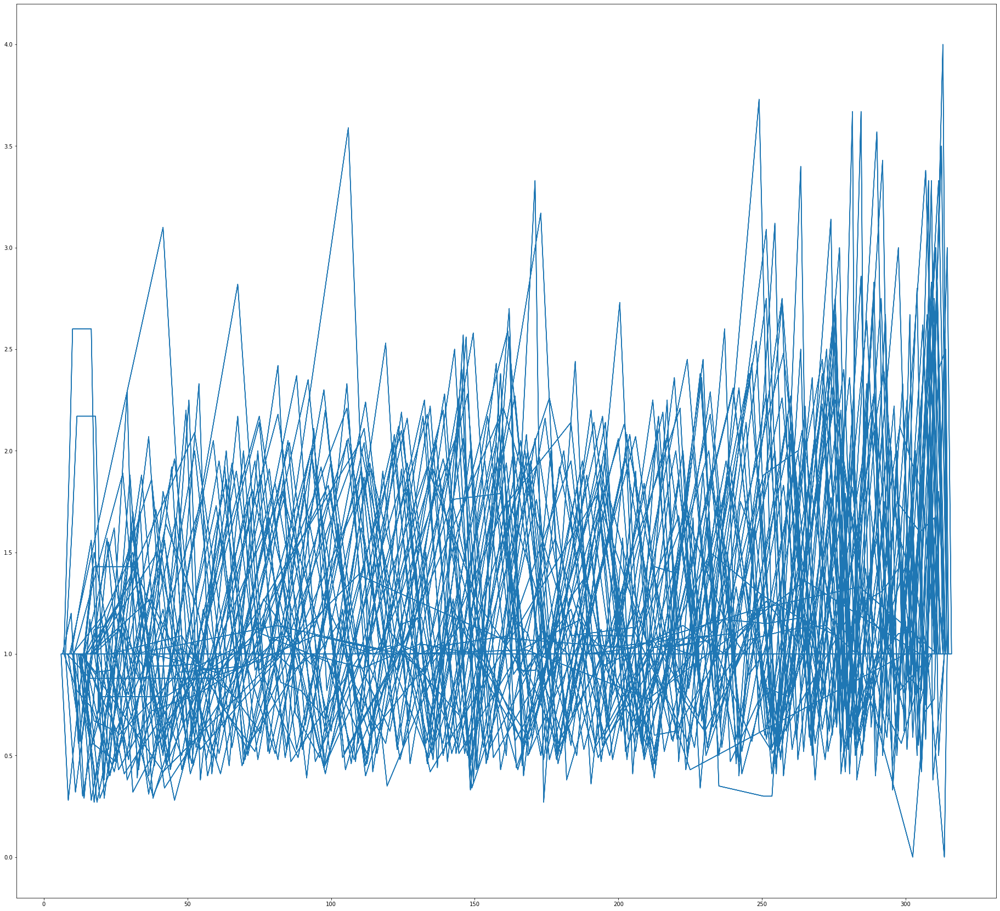

In [219]:
x,y = [],[]
for i in far_seq_factor_r2l:
    for j in i:
        x.append(j[0])
        y.append(j[1])
#p = plt.scatter(x,y)
plt.figure(figsize=(32, 30))
p = plt.plot(x,y)

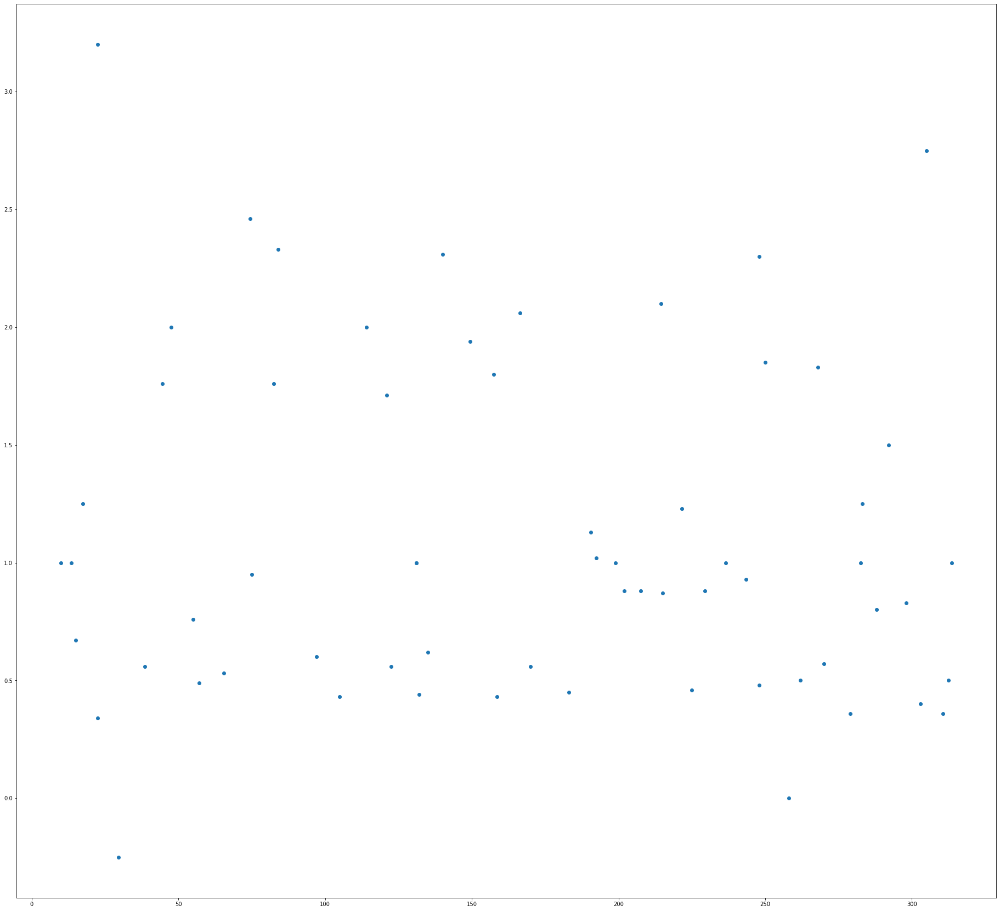

In [282]:
x,y = [],[]
for i in far_seq_factor_l2r:
    for j in i:
        x.append(j[0])
        y.append(j[1])
#p = plt.scatter(x,y)
plt.figure(figsize=(32, 30))
p = plt.scatter(x,y)

In [434]:
#result of hypothesis2
near_seq_factor_l2r_h2 = calculate_speedPosision_factor(near_seq_list_l2r,hypothesis='2')
middle_seq_factor_l2r_h2 = calculate_speedPosision_factor(middle_seq_list_l2r,hypothesis='2')
far_seq_factor_l2r_h2 = calculate_speedPosision_factor(far_seq_list_l2r,hypothesis='2')

near_seq_factor_r2l_h2 = calculate_speedPosision_factor(near_seq_list_r2l,hypothesis='2')
middle_seq_factor_r2l_h2 = calculate_speedPosision_factor(middle_seq_list_r2l,hypothesis='2')
far_seq_factor_r2l_h2 = calculate_speedPosision_factor(far_seq_list_r2l,hypothesis='2')

ZeroDivisionError: division by zero

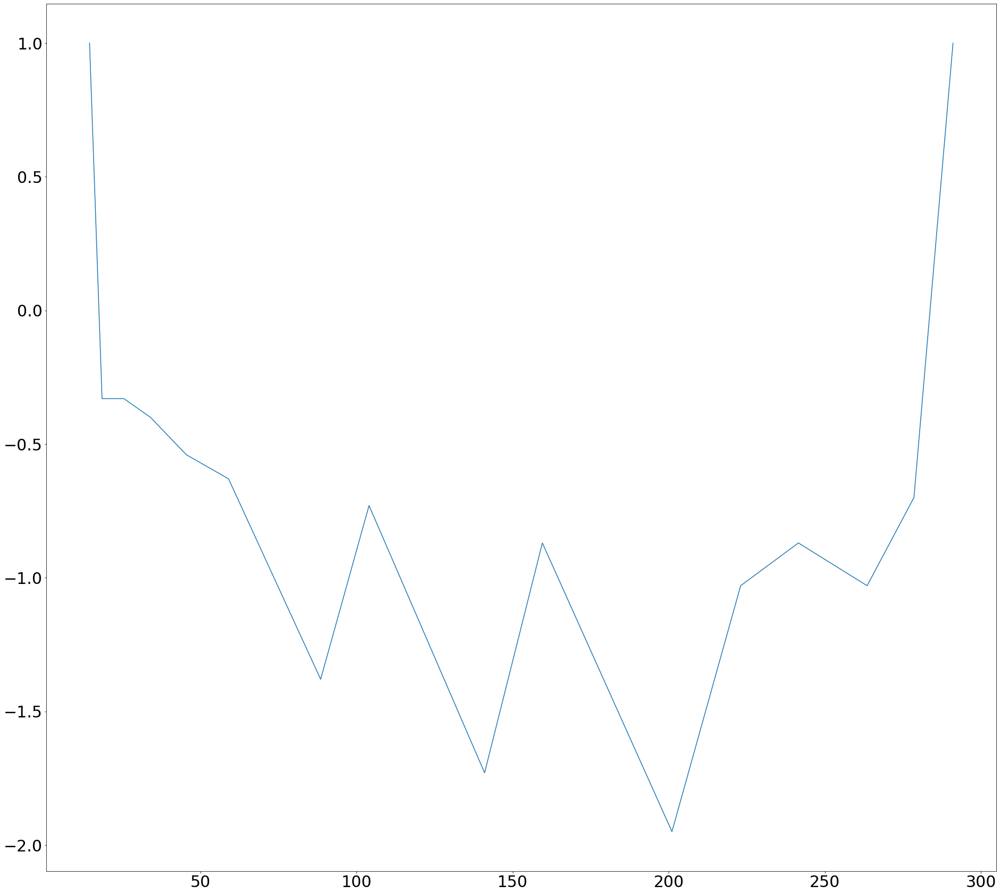

In [329]:
x,y = [],[]

for i in near_seq_factor_r2l_h2:
    for j in i:
        x.append(j[0])
        y.append(j[1])
#p = plt.scatter(x,y)
plt.figure(figsize=(32, 30))
plt.xticks(size = 30)
plt.yticks(size = 30)
p = plt.plot(x,y)

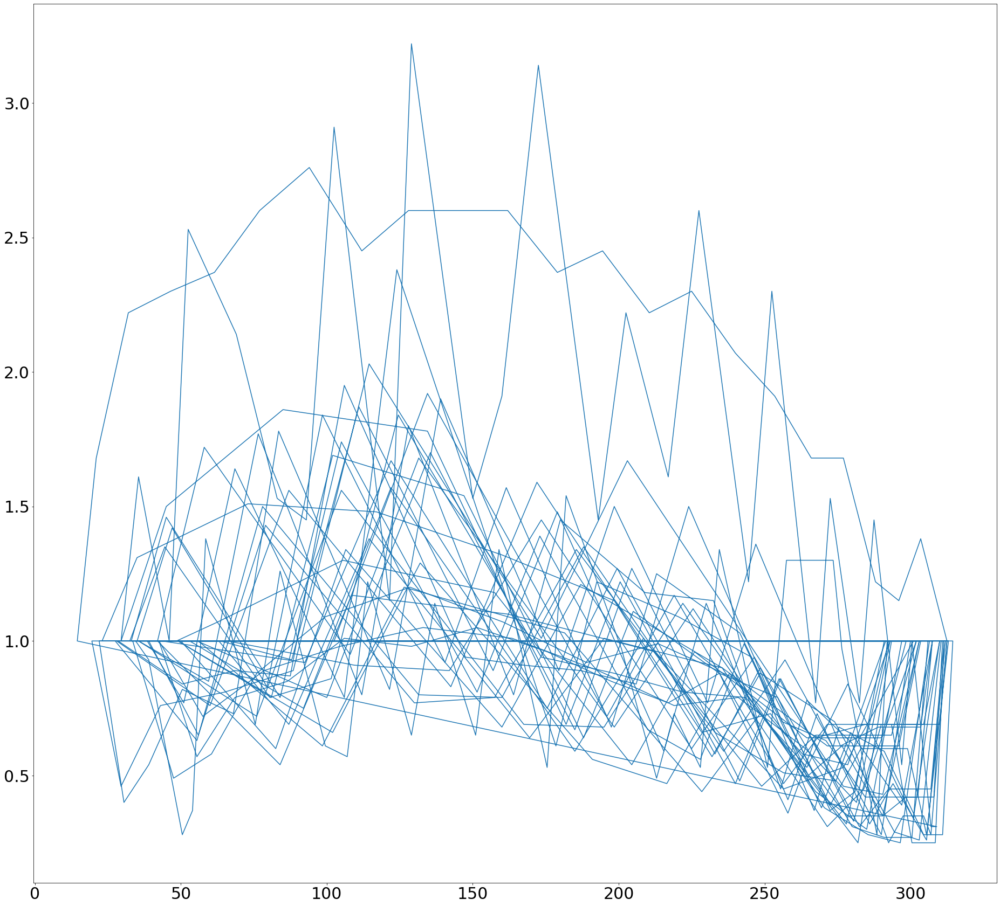

In [330]:
x,y = [],[]
for i in near_seq_factor_l2r_h2:
    for j in i:
        x.append(j[0])
        y.append(j[1])
#p = plt.scatter(x,y)
plt.figure(figsize=(32, 30))
plt.xticks(size = 30)
plt.yticks(size = 30)
p = plt.plot(x,y)

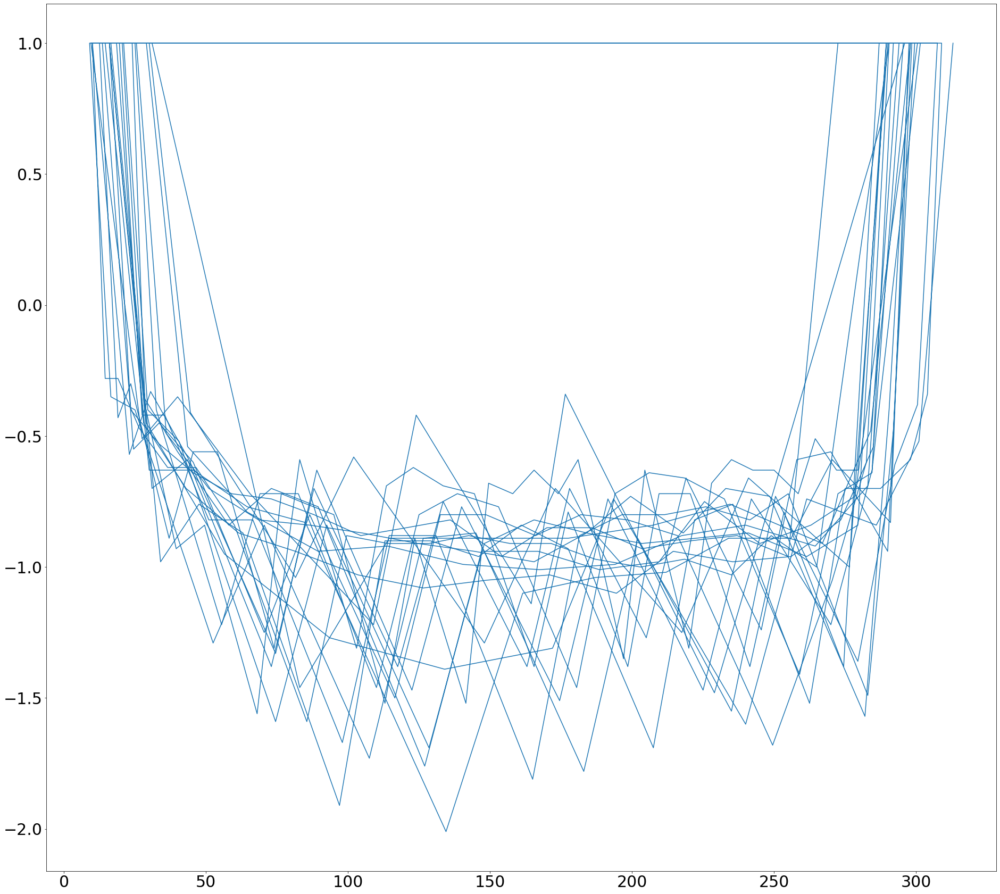

In [331]:
x,y = [],[]
for i in middle_seq_factor_r2l_h2:
    for j in i:
        x.append(j[0])
        y.append(j[1])
#p = plt.scatter(x,y)
plt.figure(figsize=(32, 30))
plt.xticks(size = 30)
plt.yticks(size = 30)
p = plt.plot(x,y)

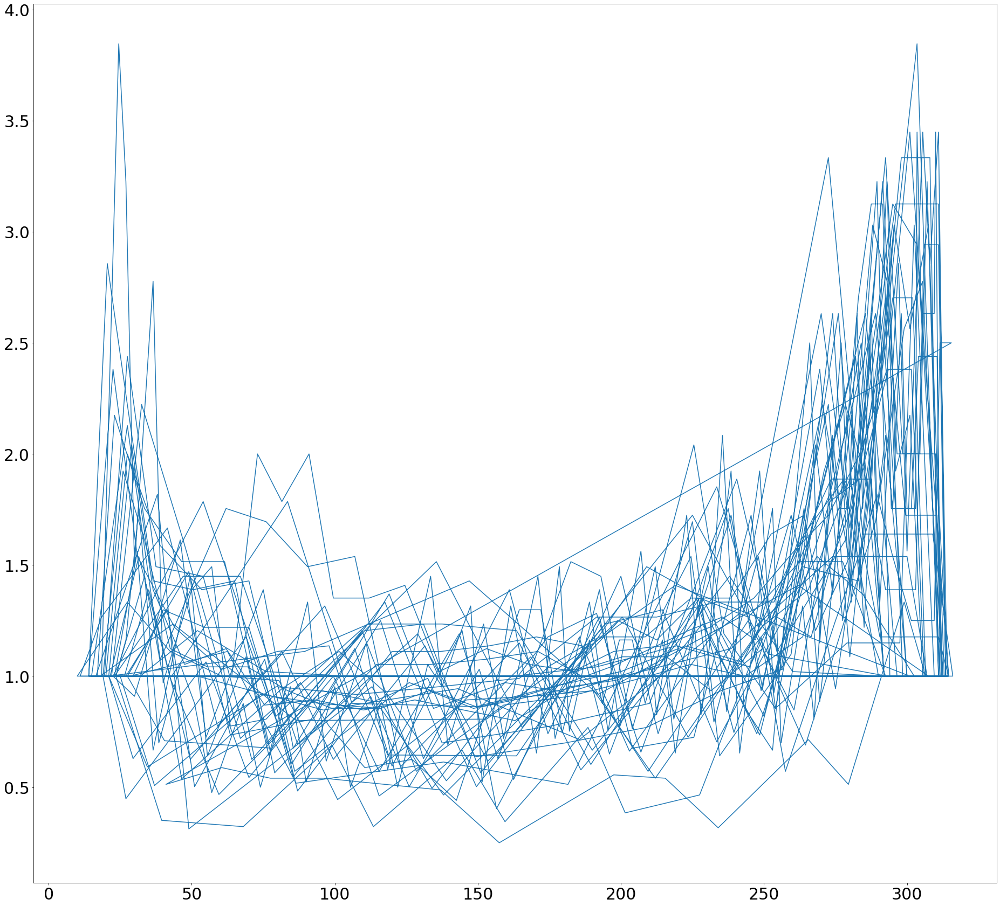

In [332]:
x,y = [],[]
for i in middle_seq_factor_l2r_h2:
    for j in i:
        x.append(j[0])
        #check reverse y 
        if j[1]== 0 :
            y.append(0)
        else:
            y.append(1/j[1])
#p = plt.scatter(x,y)
plt.figure(figsize=(32, 30))
plt.xticks(size = 30)
plt.yticks(size = 30)
p = plt.plot(x,y)

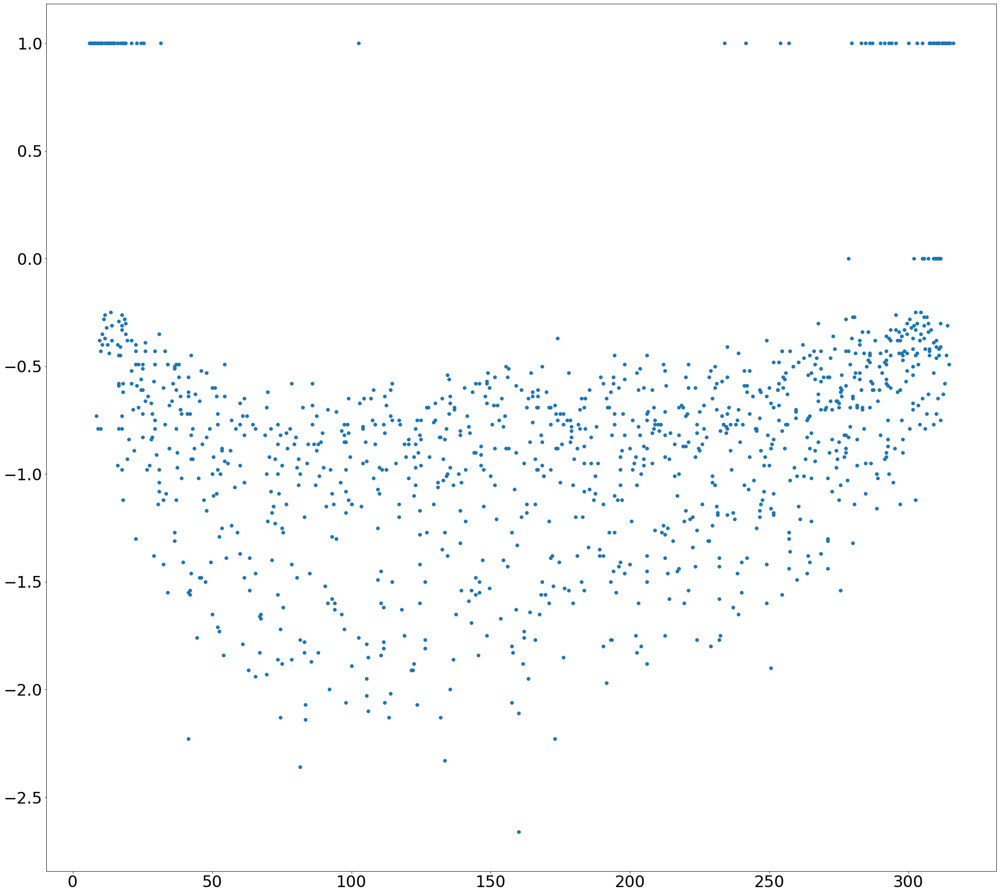

In [333]:
x,y = [],[]
for i in far_seq_factor_r2l_h2:
    for j in i:
        x.append(j[0])
        y.append(j[1])
#p = plt.scatter(x,y)
plt.figure(figsize=(32, 30))
plt.xticks(size = 30)
plt.yticks(size = 30)
p = plt.scatter(x,y)

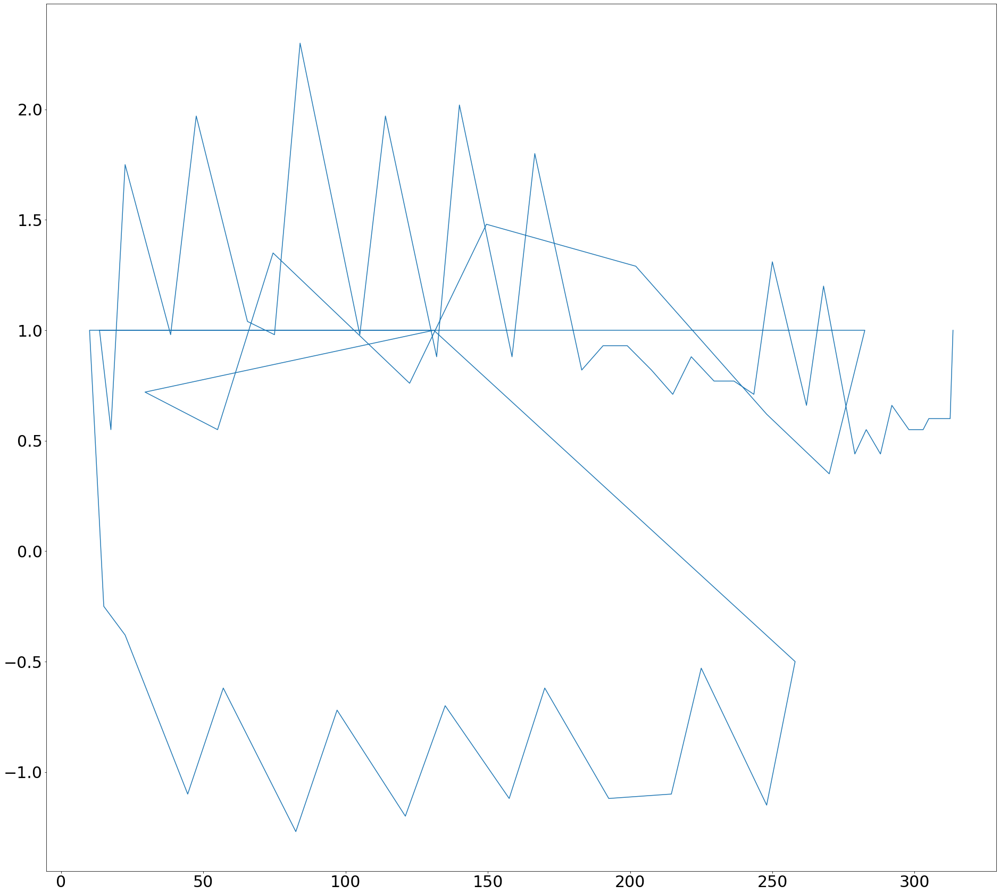

In [334]:
x,y = [],[]
for i in far_seq_factor_l2r_h2:
    for j in i:
        x.append(j[0])
        y.append(j[1])
#p = plt.scatter(x,y)
plt.figure(figsize=(32, 30))
plt.xticks(size = 30)
plt.yticks(size = 30)
p = plt.plot(x,y)

In [435]:
#result of hypothesis4

near_seq_factor_l2r_h4 = calculate_speedPosision_factor(near_seq_list_l2r,hypothesis='4')
middle_seq_factor_l2r_h4 = calculate_speedPosision_factor(middle_seq_list_l2r,hypothesis='4')
far_seq_factor_l2r_h4 = calculate_speedPosision_factor(far_seq_list_l2r,hypothesis='4')

near_seq_factor_r2l_h4 = calculate_speedPosision_factor(near_seq_list_r2l,hypothesis='4')
middle_seq_factor_r2l_h4 = calculate_speedPosision_factor(middle_seq_list_r2l,hypothesis='4')
far_seq_factor_r2l_h4 = calculate_speedPosision_factor(far_seq_list_r2l,hypothesis='4')

ZeroDivisionError: division by zero

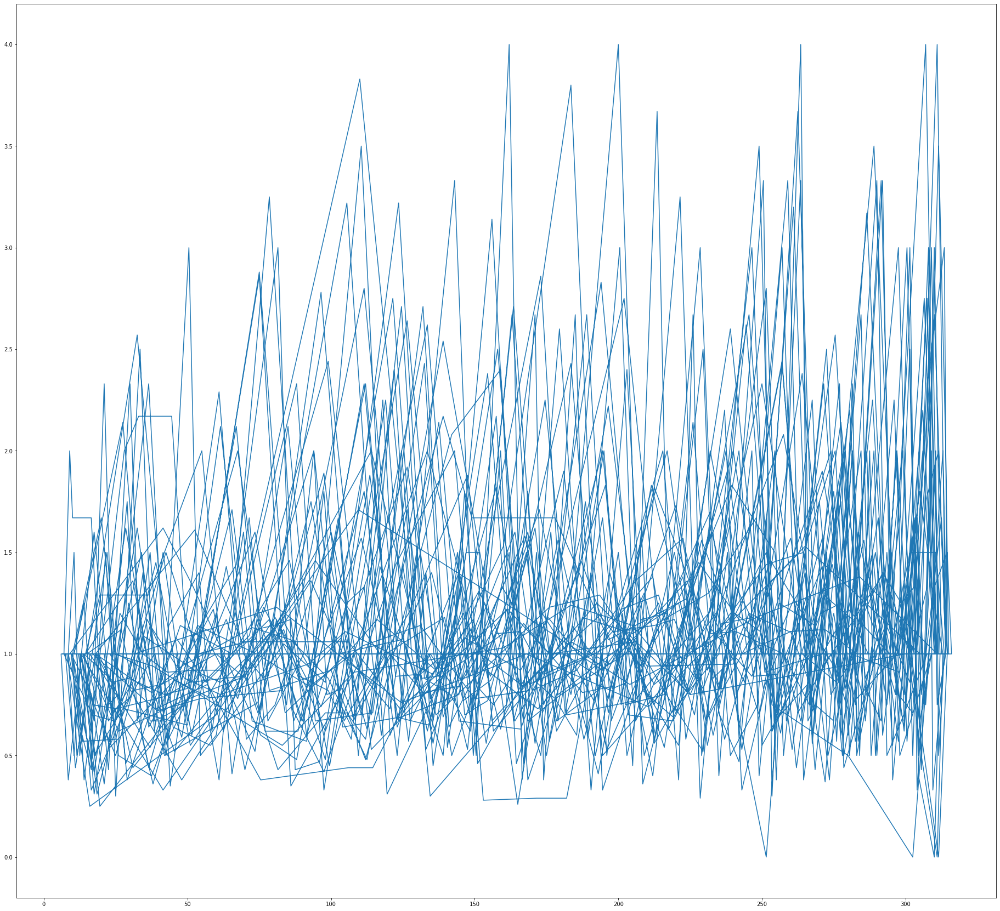

In [297]:
x,y = [],[]
for i in far_seq_factor_r2l_h4:
    for j in i:
        x.append(j[0])
        y.append(j[1])
#p = plt.scatter(x,y)
plt.figure(figsize=(32, 30))
p = plt.plot(x,y)

In [436]:
#result of hypothesis5
hypo = '5'
near_seq_factor_l2r_h5 = calculate_speedPosision_factor(near_seq_list_l2r,hypothesis=hypo)
middle_seq_factor_l2r_h5 = calculate_speedPosision_factor(middle_seq_list_l2r,hypothesis=hypo)
far_seq_factor_l2r_h5 = calculate_speedPosision_factor(far_seq_list_l2r,hypothesis=hypo)

near_seq_factor_r2l_h5 = calculate_speedPosision_factor(near_seq_list_r2l,hypothesis=hypo)
middle_seq_factor_r2l_h5 = calculate_speedPosision_factor(middle_seq_list_r2l,hypothesis=hypo)
far_seq_factor_r2l_h5 = calculate_speedPosision_factor(far_seq_list_r2l,hypothesis=hypo)

average time per frame is : 136.66666666666666
average time per frame is : 134.30769230769232
average time per frame is : 137.7391304347826
average time per frame is : 137.03333333333333
average time per frame is : 132.48837209302326
average time per frame is : 131.57407407407408
average time per frame is : 129.6031746031746
average time per frame is : 129.50666666666666
average time per frame is : 130.8372093023256
average time per frame is : 129.70652173913044
average time per frame is : 129.6969696969697
average time per frame is : 128.52830188679246
average time per frame is : 126.25
average time per frame is : 126.34126984126983
average time per frame is : 125.32089552238806
average time per frame is : 122.51351351351352
average time per frame is : 121.96794871794872
average time per frame is : 121.04268292682927
average time per frame is : 118.74712643678161
average time per frame is : 121.41206030150754
average time per frame is : 119.30952380952381
average time per frame is : 1

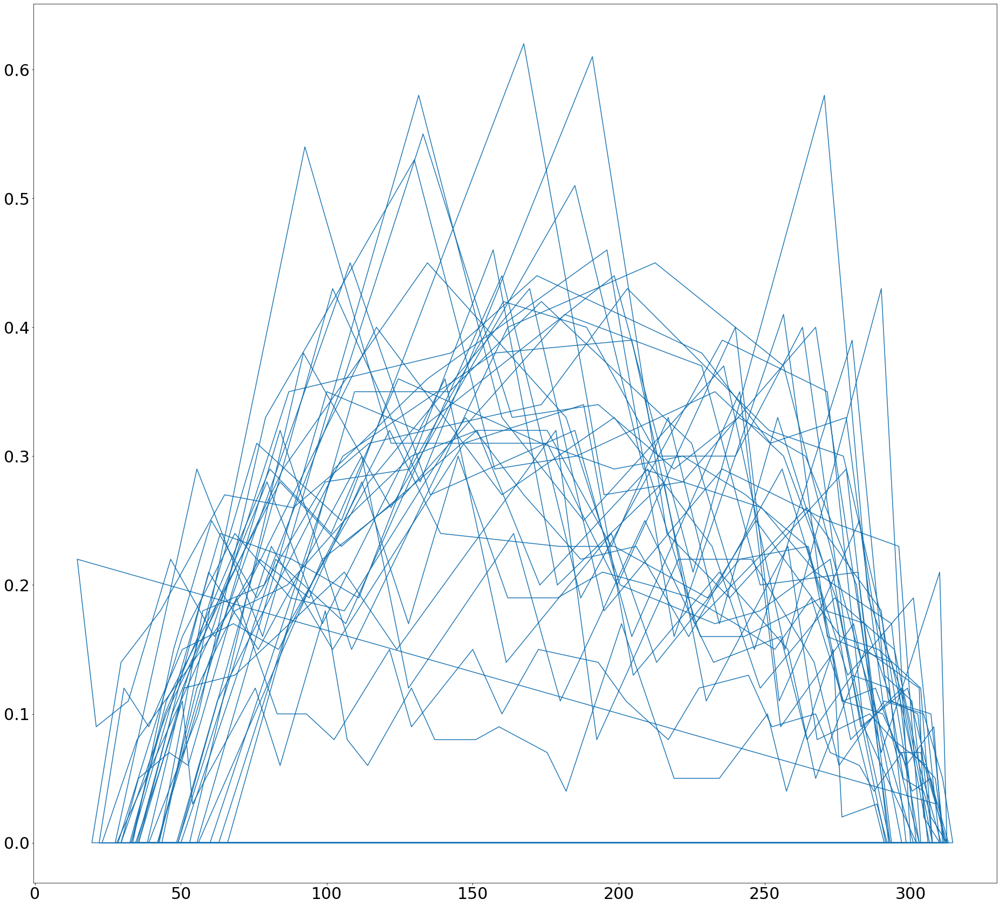

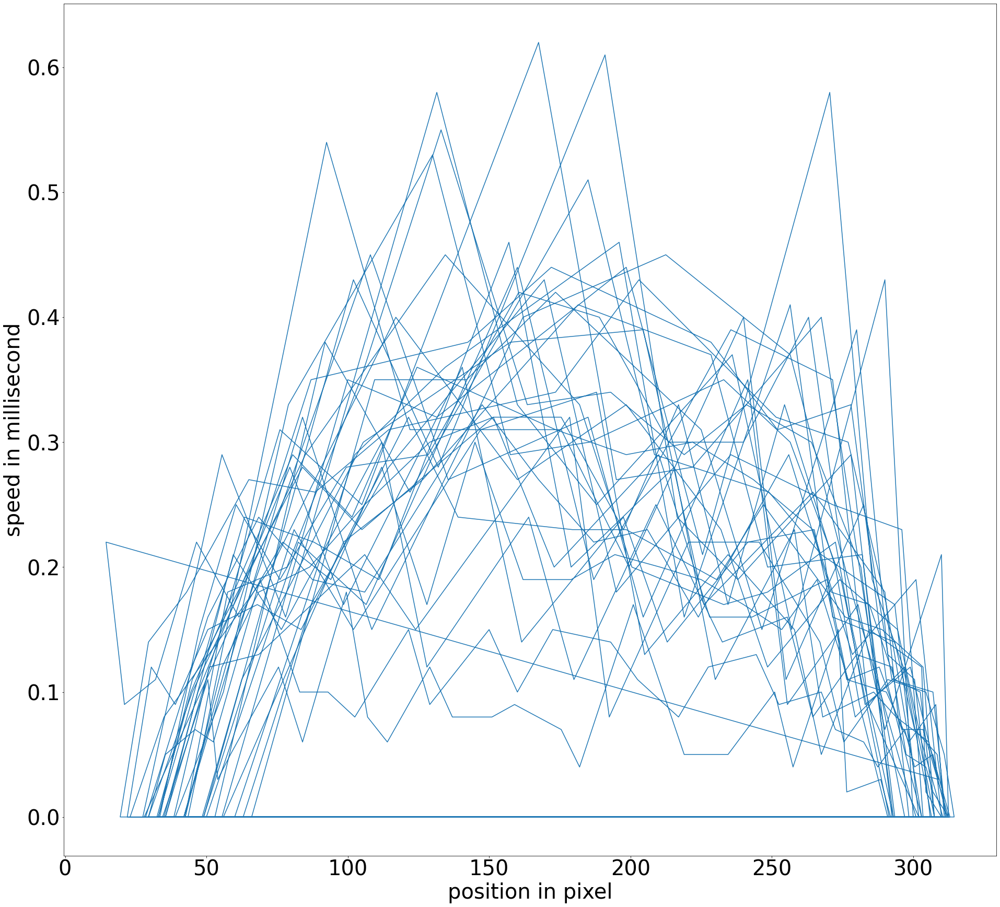

In [437]:
x,y = [],[]
for i in near_seq_factor_l2r_h5:
    for j in i:
        x.append(j[0])
        if j[1]==1:
            y.append(0)
        else:        
            y.append(j[1])
#p = plt.scatter(x,y)
plt.figure(figsize=(32, 30))
plt.xticks(size = 30)
plt.yticks(size = 30)
p = plt.plot(x,y)
plt.figure(figsize=(32, 30))
plt.xlabel('position in pixel',size=40)
plt.ylabel('speed in millisecond',size=40)
plt.xticks(size = 40)
plt.yticks(size = 40)
p = plt.plot(x,y)
plt.savefig('near_seq_factor_l2r_h5.png')


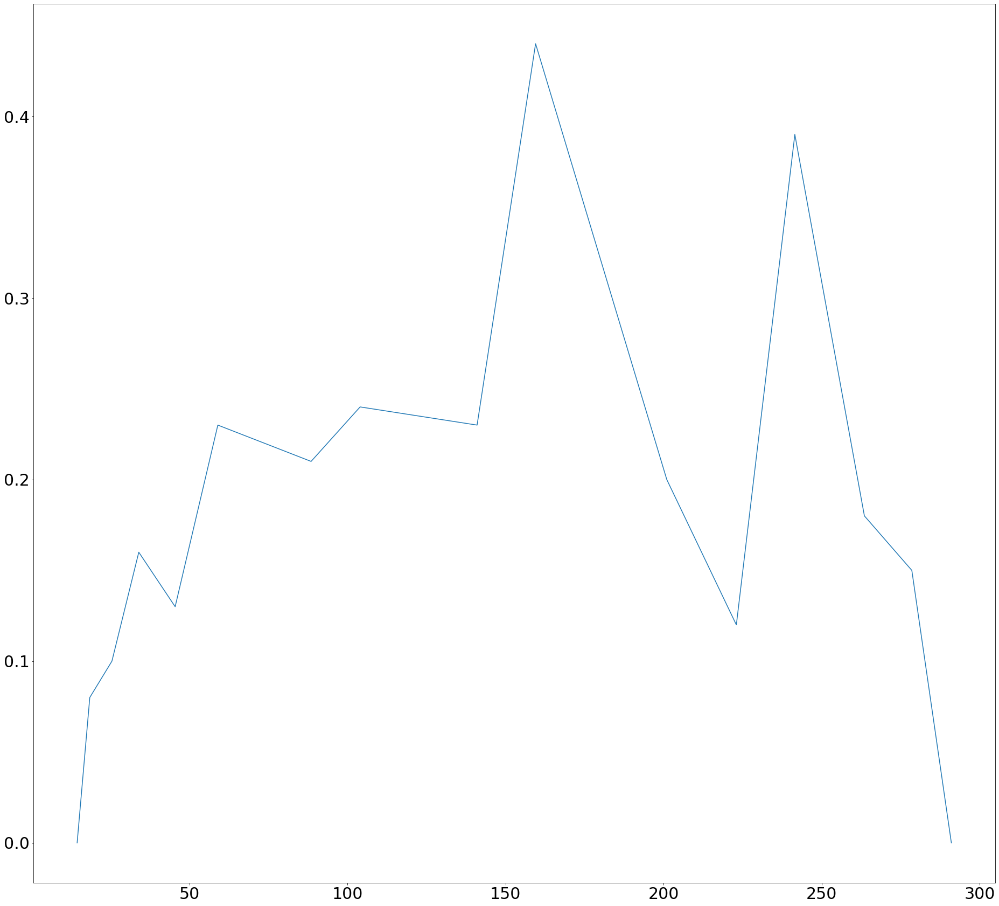

In [343]:
x,y = [],[]
for i in near_seq_factor_r2l_h5:
    for j in i:
        x.append(j[0])
        if j[1]==1:
            y.append(0)
        else:        
            y.append(j[1])
#p = plt.scatter(x,y)

plt.figure(figsize=(32, 30))
plt.xticks(size = 30)
plt.yticks(size = 30)
p = plt.plot(x,y)

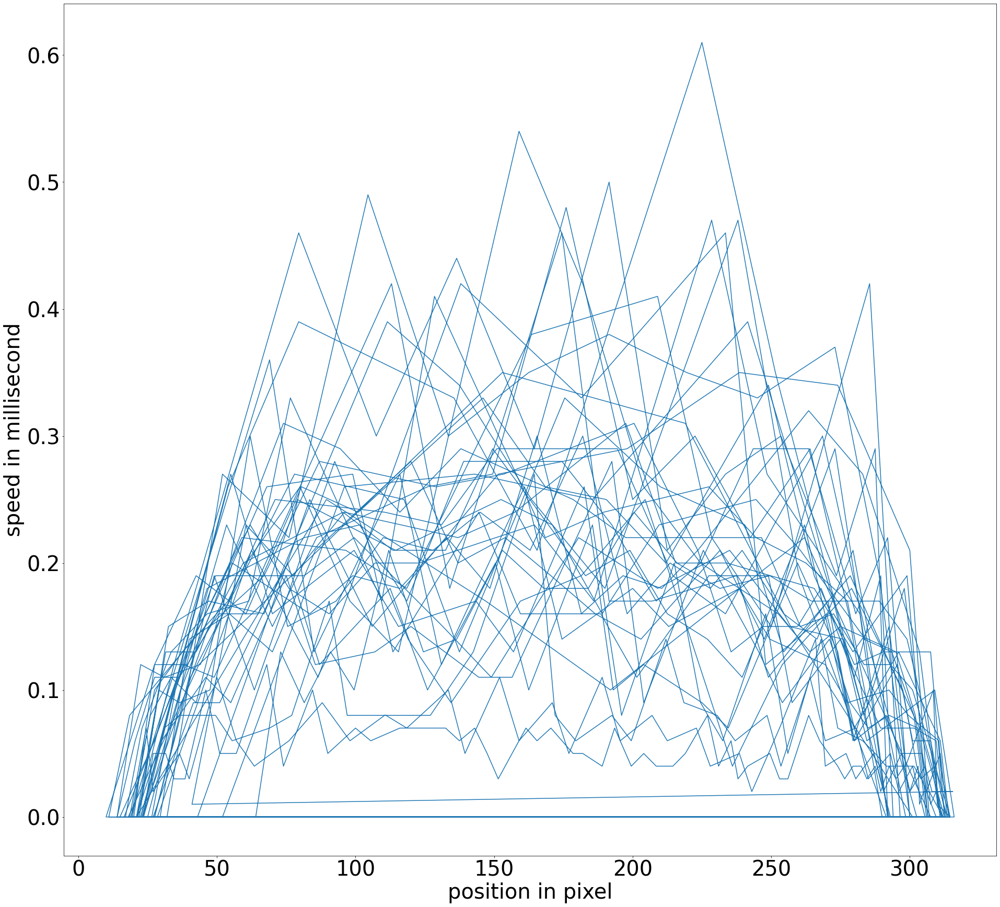

In [438]:
x,y = [],[]
for i in middle_seq_factor_l2r_h5:
    for j in i:
        x.append(j[0])
        if j[1]==1:
            y.append(0)
        else:        
            y.append(j[1])
#p = plt.scatter(x,y)

plt.figure(figsize=(32, 30))
plt.xlabel('position in pixel',size=40)
plt.ylabel('speed in millisecond',size=40)
plt.xticks(size = 40)
plt.yticks(size = 40)
p = plt.plot(x,y)
plt.savefig('middle_seq_factor_l2r_h5.png')

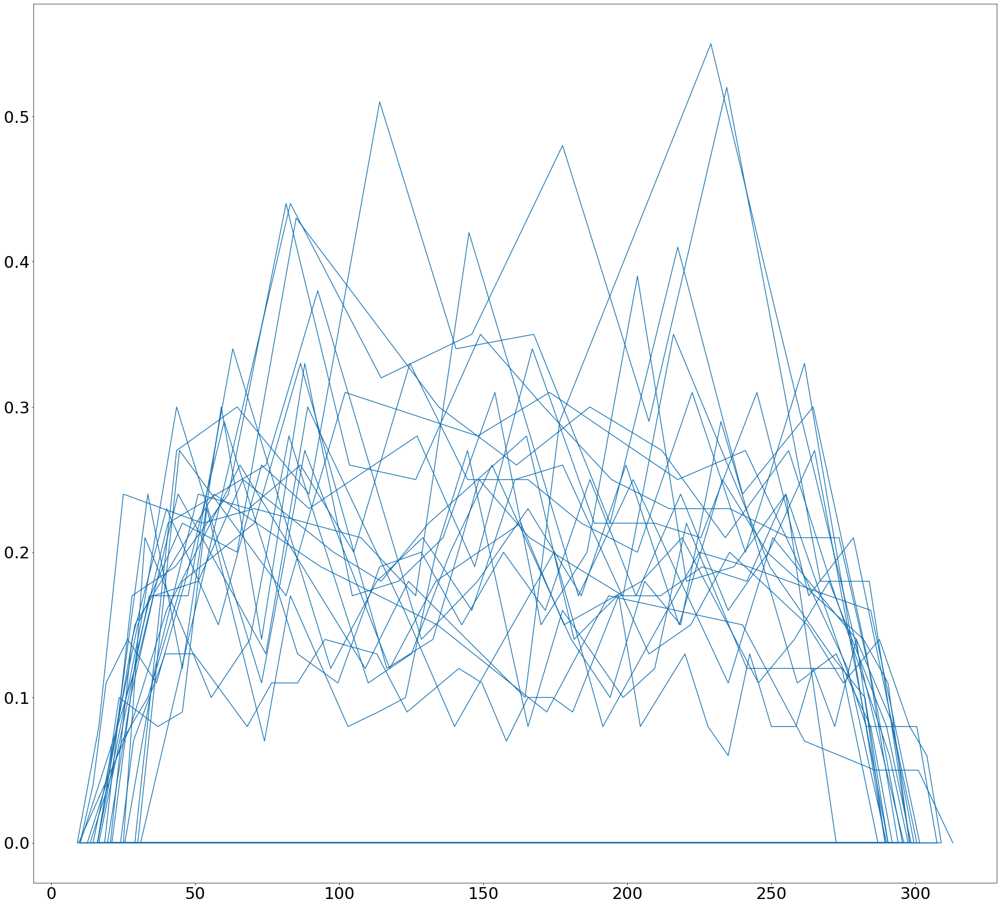

In [349]:
x,y = [],[]
for i in middle_seq_factor_r2l_h5:
    for num,j in enumerate(i):
        x.append(j[0])
        if j[1]==1:
            y.append(0)
        elif j[1]>4:
            y.append(i[num-2][1])
        else:        
            y.append(j[1])
#p = plt.scatter(x,y)

plt.figure(figsize=(32, 30))
plt.xticks(size = 30)
plt.yticks(size = 30)
p = plt.plot(x,y)

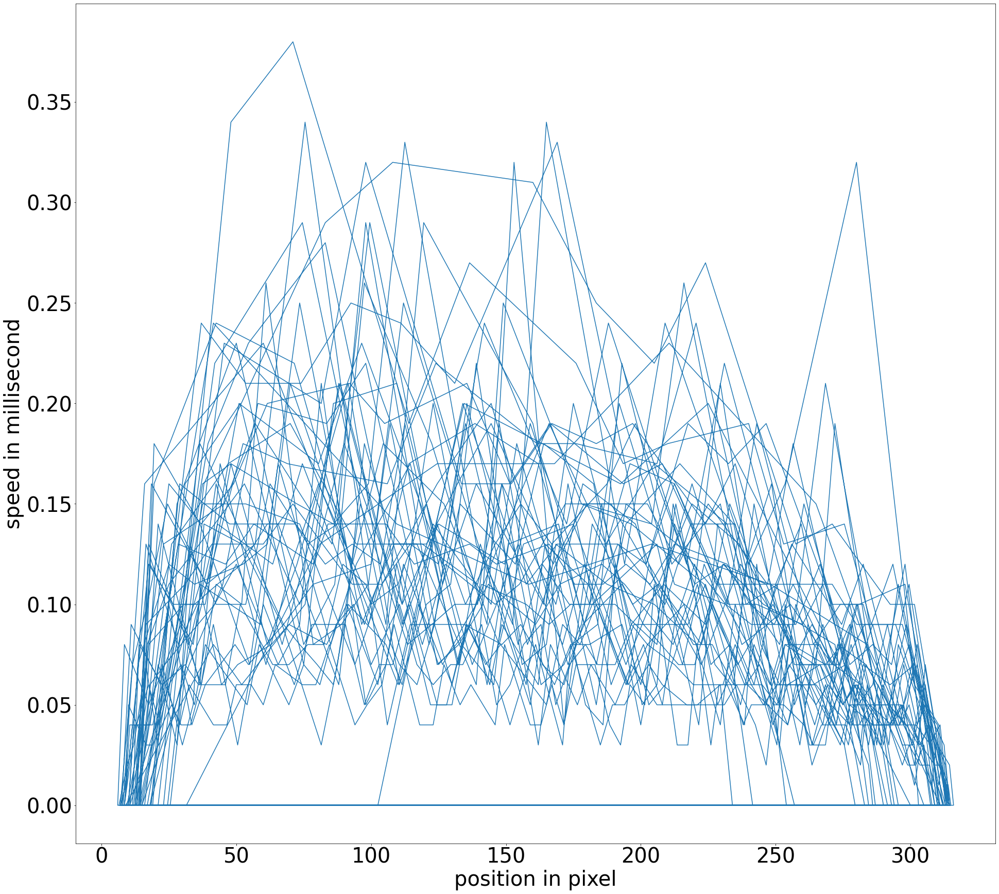

In [439]:
x,y = [],[]
for i in far_seq_factor_r2l_h5:
    for j in i:
        x.append(j[0])
        if j[1]==1:
            y.append(0)
        else:        
            y.append(j[1])
#p = plt.scatter(x,y)
plt.figure(figsize=(32, 30))
plt.xlabel('position in pixel',size=40)
plt.ylabel('speed in millisecond',size=40)
plt.xticks(size = 40)
plt.yticks(size = 40)
p = plt.plot(x,y)
plt.savefig('far_seq_factor_r2l_h5.png')

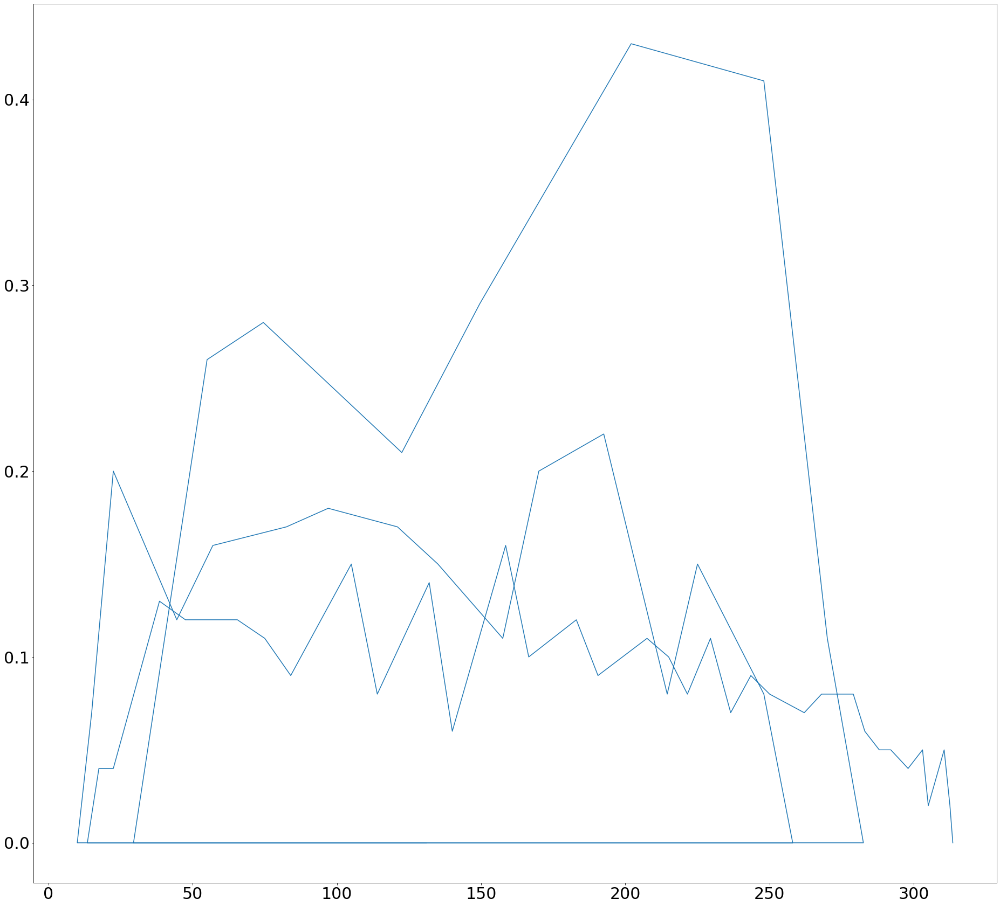

In [347]:
x,y = [],[]
for i in far_seq_factor_l2r_h5:
    for j in i:
        x.append(j[0])
        if j[1]==1:
            y.append(0)
        else:        
            y.append(j[1])
#p = plt.scatter(x,y)

plt.figure(figsize=(32, 30))
plt.xticks(size = 30)
plt.yticks(size = 30)
p = plt.plot(x,y)

The visulisation of the result of the 5th hypothesis shows strong relationship between position of object, ( as well how big is the object) and the speed changes. Next we will the the random forest to predict the delta s(speed change rate of a given position) based on the current position and the size of the object.

In [440]:
# build data for prediction
#result of hypothesis5
hypo = '5'
mode ='prediction_prep'
near_seq_factor_l2r_h5 = calculate_speedPosision_factor(near_seq_list_l2r,hypothesis=hypo,mode=mode)
middle_seq_factor_l2r_h5 = calculate_speedPosision_factor(middle_seq_list_l2r,hypothesis=hypo,mode=mode)
far_seq_factor_l2r_h5 = calculate_speedPosision_factor(far_seq_list_l2r,hypothesis=hypo,mode=mode)

near_seq_factor_r2l_h5 = calculate_speedPosision_factor(near_seq_list_r2l,hypothesis=hypo,mode=mode)
middle_seq_factor_r2l_h5 = calculate_speedPosision_factor(middle_seq_list_r2l,hypothesis=hypo,mode=mode)
far_seq_factor_r2l_h5 = calculate_speedPosision_factor(far_seq_list_r2l,hypothesis=hypo,mode=mode)

average time per frame is : 136.66666666666666
average time per frame is : 134.30769230769232
average time per frame is : 137.7391304347826
average time per frame is : 137.03333333333333
average time per frame is : 132.48837209302326
average time per frame is : 131.57407407407408
average time per frame is : 129.6031746031746
average time per frame is : 129.50666666666666
average time per frame is : 130.8372093023256
average time per frame is : 129.70652173913044
average time per frame is : 129.6969696969697
average time per frame is : 128.52830188679246
average time per frame is : 126.25
average time per frame is : 126.34126984126983
average time per frame is : 125.32089552238806
average time per frame is : 122.51351351351352
average time per frame is : 121.96794871794872
average time per frame is : 121.04268292682927
average time per frame is : 118.74712643678161
average time per frame is : 121.41206030150754
average time per frame is : 119.30952380952381
average time per frame is : 1

In [441]:

def change_seq_direction_to_l2r(seqs):
    for nums,i in enumerate(seqs):
        for nums2,j in enumerate(i):
            #print(j[0])
            seqs[nums][nums2][0] = 320-int(j[0])
            #print(seqs)


In [442]:
# change all the sequence to the same direction, by turing the sequence from right to left into left to right
change_seq_direction_to_l2r(near_seq_factor_r2l_h5) 
change_seq_direction_to_l2r(middle_seq_factor_r2l_h5)
change_seq_direction_to_l2r(far_seq_factor_r2l_h5)

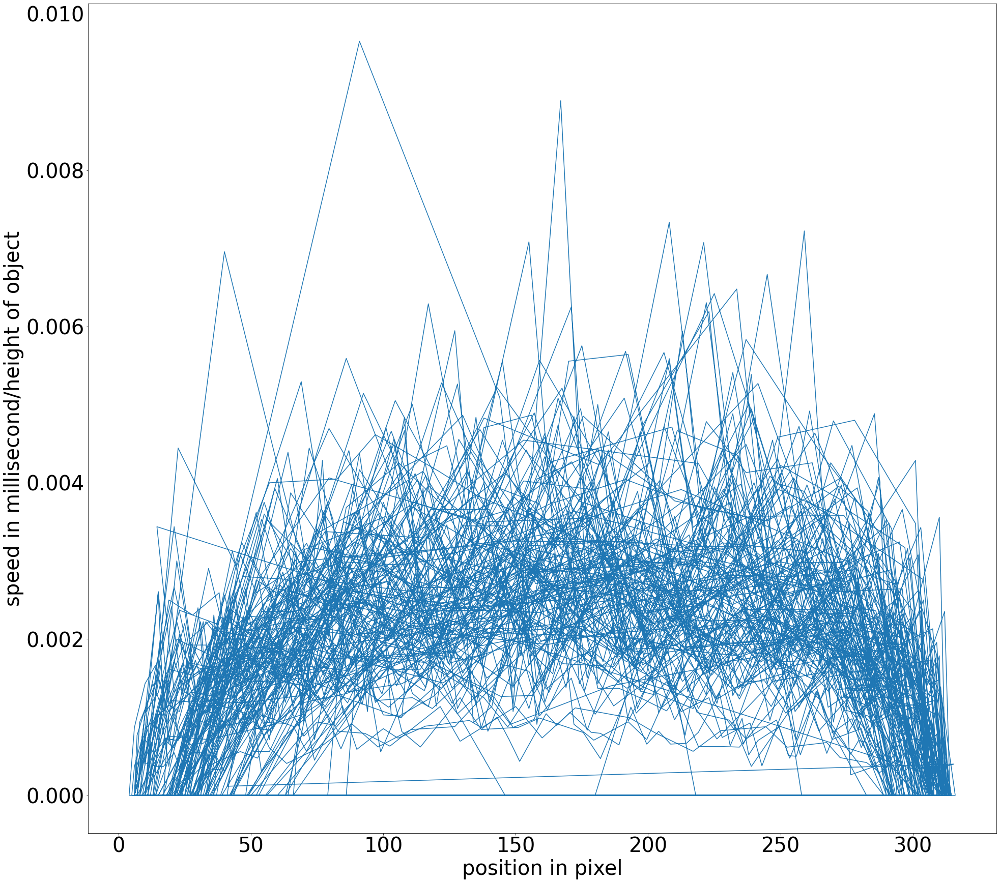

In [443]:
# format [x,y,w,h,speed]
plt.figure(figsize=(32, 30))
plt.xlabel('position in pixel',size=40)
plt.ylabel('speed in millisecond/height of object',size=40)
plt.xticks(size = 40)
plt.yticks(size = 40)
all_seq = [near_seq_factor_r2l_h5,near_seq_factor_l2r_h5,middle_seq_factor_r2l_h5,middle_seq_factor_l2r_h5,far_seq_factor_r2l_h5,far_seq_factor_l2r_h5]
x,y = [],[]
for k in all_seq:
    for i in k:
        for j in i:
            x.append(j[0])
            if j[-1]>3:
                y.append(0)
            else:        
                y.append(j[-1]/(j[-2]))
        #p = plt.scatter(x,y)

    p = plt.plot(x,y)
plt.savefig('all_seq_speed_divide_height.png')

In [405]:
# build random forest model
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
from sklearn import metrics


In [401]:
#the model input (x,w*h) -> output(speed/h)
# format [x,y,w,h,speed]
all_seq = [near_seq_factor_r2l_h5,near_seq_factor_l2r_h5,middle_seq_factor_r2l_h5,middle_seq_factor_l2r_h5,far_seq_factor_r2l_h5,far_seq_factor_l2r_h5]
X,y = [],[]
for k in all_seq:
    for num1,i in enumerate(k):
        for num2,j in enumerate(i):
            X.append([j[0],j[2]*j[3]])
            if j[-1]>3:
                print(i[num2][-1]/(j[-2]))
                y.append(i[num2-2][-1]/(j[-2]))
                print(i[num2-2][-1]/(j[-2]))
            else:        
                y.append(j[-1]/(j[-2]))
        #p = plt.scatter(x,y)


0.05246913580246913
0.0024691358024691358
0.05939759036144578
0.000963855421686747


In [402]:
X_train, X_test, y_train, y_test = train_test_split(X,
                                                    y,
                                                    test_size=0.2,
                                                    random_state=0)



In [410]:
print(X[0])

[29, 6264]


In [419]:
regressor = RandomForestRegressor(n_estimators=200, random_state=0)
regressor.fit(X_train, y_train)
y_pred = regressor.predict(X_test)

In [420]:
print('Mean Absolute Error:', metrics.mean_absolute_error(y_test, y_pred))
print('Mean Squared Error:', metrics.mean_squared_error(y_test, y_pred))
print('Root Mean Squared Error:',
      np.sqrt(metrics.mean_squared_error(y_test, y_pred)))


Mean Absolute Error: 0.0008046285026777547
Mean Squared Error: 1.162291893059098e-06
Root Mean Squared Error: 0.0010780964210399262


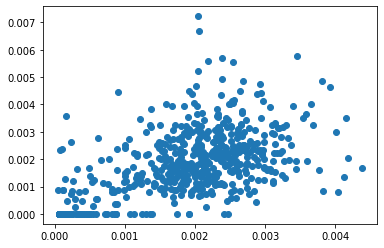

In [421]:
plt.figure(figsize=(32, 30))

plt.scatter(y_pred,y_test) #simple,randomforest,average y-train as average velocity 
# better initial number
# hybrid model 
# base line average parameter 
# must compare it in the right way
plt.savefig('all_seq_speed_divide_height.png')

In [409]:
#save the model
import pickle

with open("model_randomForest.pkl", "wb") as f:
    pickle.dump(regressor, f)